In [1]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="0XyC6GWdsX9dgNagE50c")
project = rf.workspace("ey-storm-damage").project("storm-damage-nkyfj")
version = project.version(8)
dataset = version.download("yolov8")

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.1/74.1 kB 1.4 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 3.2 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 9.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 30.5 MB/s eta 0:00:00:00:0100:01
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.9.0.80
    Uninstalling opencv-python-headless-4.9.0.80:
      Successfully uninstalled opencv-python-headless-4.9.0.80
  Attempting uninstall: idna
    Found existing installation: idna 3.6
    Uninstalling idna-3.6:
      Successfully uninstalled idna-3.6
  Attempting uninstall: cycler
    Found existing installation: cycler 0.12.1
    Uninstalling cycler-0.12.1:
      Successfully uninstalled cycler-0.12.1
  Attempting uninstall: certifi
    Found existing install


Extracting Dataset Version Zip to Storm-Damage-8 in yolov8:: 100%|██████████| 774/774 [00:00<00:00, 6935.13it/s]


In [2]:
# Import model
%pip install ultralytics
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.4/40.4 kB 604.3 kB/s eta 0:00:00 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 750.8/750.8 kB 5.0 MB/s eta 0:00:0000:0100:01
Note: you may need to restart the kernel to use updated packages.


In [3]:
# Importing the required libraries
from ultralytics import YOLO
import squarify
import matplotlib.pyplot as plt
import cv2
import os
import random
import pandas as pd
import numpy as np
import matplotlib.image as mpimg
import seaborn as sns
import yaml
import io
import torch
from PIL import Image
from torchvision import transforms
import shutil

sns.set_style('darkgrid')

%matplotlib inline

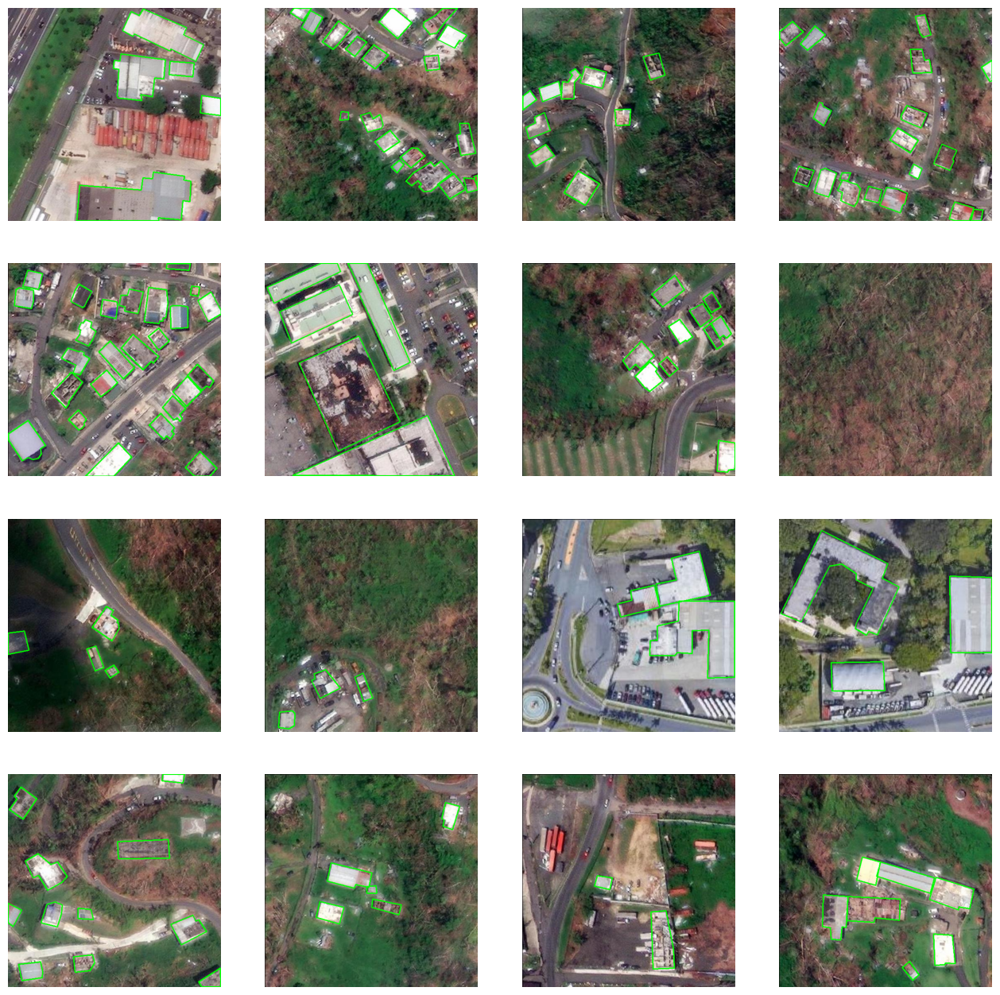

In [4]:
# Define the paths to the images and labels directories
train_images = "/kaggle/working/Storm-Damage-8/train/images"
train_labels = "/kaggle/working/Storm-Damage-8/train/labels"

test_images = "/kaggle/working/Storm-Damage-8/test/images"
test_labels = "/kaggle/working/Storm-Damage-8/test/labels"

val_images = "/kaggle/working/Storm-Damage-8/valid/images"
val_labels = "/kaggle/working/Storm-Damage-8/valid/labels"

# Get a list of all the image files in the training images directory
image_files = os.listdir(train_images)

# Choose 16 random image files from the list
random_images = random.sample(image_files, 16)

# Set up the plot
fig, axs = plt.subplots(4, 4, figsize=(16, 16))

# Loop over the random images and plot the object detections
for i, image_file in enumerate(random_images):
    row = i // 4
    col = i % 4

    # Load the image
    image_path = os.path.join(train_images, image_file)
    image = cv2.imread(image_path)

    # Load the labels for this image
    label_file = os.path.splitext(image_file)[0] + ".txt"
    label_path = os.path.join(train_labels, label_file)
    with open(label_path, "r") as f:
        labels = f.read().strip().split("\n")

    # Loop over the labels and plot the polygon detections
    for label in labels:
        parts = list(map(float, label.split()))
        if len(parts) < 3:  # Skip invalid labels
            continue
        # Assuming class_id followed by pairs of x, y for vertices
        vertices = [(int(parts[j] * image.shape[1]), int(parts[j + 1] * image.shape[0])) for j in range(1, len(parts), 2)]
        vertices_np = np.array(vertices, np.int32)
        vertices_np = vertices_np.reshape((-1, 1, 2))
        cv2.polylines(image, [vertices_np], isClosed=True, color=(0, 255, 0), thickness=2)

    # Show the image with the object detections
    axs[row, col].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axs[row, col].axis('off')

plt.show()

#### Labels:
##### 0: Damaged Commercial Building
##### 1: Damaged Residential Building
##### 2: Undamaged Commercial Building
##### 3: Undamaged Residential Building

In [5]:
bda_dir = '/kaggle/working/Storm-Damage-8/bda'
btc_dir = '/kaggle/working/Storm-Damage-8/btc'

In [6]:
# Remove if these are files
if not os.path.isdir(bda_dir) and os.path.exists(bda_dir):
    os.remove(bda_dir)
if not os.path.isdir(btc_dir) and os.path.exists(btc_dir):
    os.remove(btc_dir)

# Ensure directories exist
os.makedirs(bda_dir, exist_ok=True)
os.makedirs(btc_dir, exist_ok=True)

In [7]:
# Base directory
base_dir = '/kaggle/working/Storm-Damage-8/'

# Operations for 'bda'
shutil.copy(os.path.join(base_dir, 'data.yaml'), os.path.join(bda_dir, 'data_bda.yaml'))
for folder in ['train', 'test', 'valid']:
    src = os.path.join(base_dir, folder)
    dst = os.path.join(bda_dir, folder + '_bda')
    shutil.copytree(src, dst)

# Operations for 'btc'
shutil.copy(os.path.join(base_dir, 'data.yaml'), os.path.join(btc_dir, 'data_btc.yaml'))
for folder in ['train', 'test', 'valid']:
    src = os.path.join(base_dir, folder)
    dst = os.path.join(btc_dir, folder + '_btc')
    shutil.copytree(src, dst)

In [8]:
# Load an image using OpenCV
image = cv2.imread("/kaggle/working/Storm-Damage-8/train/images/Pre_Event_019_jpg.rf.bb77b85c4de16be54881e512f9fbda24.jpg")

# Get the size of the image
height, width, channels = image.shape
print(f"The image has dimensions {width}x{height} and {channels} channels.")

The image has dimensions 512x512 and 3 channels.


In [9]:
dirs_bda = {
    'train': '/kaggle/working/Storm-Damage-8/bda/train_bda/labels/',
    'test': '/kaggle/working/Storm-Damage-8/bda/test_bda/labels/',
    'valid': '/kaggle/working/Storm-Damage-8/bda/valid_bda/labels/'
}

# Modify class IDs for BDA
def modify_for_bda(class_id):
    if class_id in [0, 1]:  # Damaged
        return '0'
    elif class_id in [2, 3]:  # Undamaged
        return '1'

# Process each directory
def process_directory(directory):
    for filename in os.listdir(directory):
        if filename.endswith(".txt"):  # Assuming text files for YOLO format
            filepath = os.path.join(directory, filename)
            with open(filepath, 'r') as file:
                lines = file.readlines()
            with open(filepath, 'w') as file:
                for line in lines:
                    parts = line.split()
                    if parts:
                        original_class_id = int(parts[0])
                        new_class_id = modify_for_bda(original_class_id)
                        parts[0] = new_class_id 
                        new_line = ' '.join(parts) + '\n'
                        file.write(new_line)
                    else:
                        file.write(line)

# Apply modifications for each set
for key, directory in dirs_bda.items():
    process_directory(directory)
    
print("Modification successfully.")

Modification successfully.


In [10]:
dirs_btc = {
    'train': '/kaggle/working/Storm-Damage-8/btc/train_btc/labels/',
    'test': '/kaggle/working/Storm-Damage-8/btc/test_btc/labels/',
    'valid': '/kaggle/working/Storm-Damage-8/btc/valid_btc/labels/'
}

# Modify class IDs for BTC
def modify_for_btc(class_id):
    if class_id in [0, 2]:  # Commercial
        return '0'
    elif class_id in [1, 3]:  # Residential
        return '1'

# Process each directory
def process_directory(directory):
    for filename in os.listdir(directory):
        if filename.endswith(".txt"):  # Assuming text files for YOLO format
            filepath = os.path.join(directory, filename)
            with open(filepath, 'r') as file:
                lines = file.readlines()
            with open(filepath, 'w') as file:
                for line in lines:
                    parts = line.split()
                    if parts: 
                        original_class_id = int(parts[0])
                        new_class_id = modify_for_btc(original_class_id)
                        parts[0] = new_class_id 
                        new_line = ' '.join(parts) + '\n'
                        file.write(new_line)
                    else:
                        file.write(line)

# Apply modifications for each set
for key, directory in dirs_btc.items():
    process_directory(directory)
    
print("Modification successfully.")

Modification successfully.


In [11]:
with open("/kaggle/working/Storm-Damage-8/data.yaml") as stream:
    try:
        print(yaml.safe_load(stream))
    except yaml.YAMLError as exc:
        print(exc)

{'names': ['Damaged Commercial Building', 'Damaged Residential Building', 'Undamaged Commercial Building', 'Undamaged Residential Building'], 'nc': 4, 'roboflow': {'license': 'Public Domain', 'project': 'storm-damage-nkyfj', 'url': 'https://universe.roboflow.com/ey-storm-damage/storm-damage-nkyfj/dataset/8', 'version': 8, 'workspace': 'ey-storm-damage'}, 'test': '../test/images', 'train': 'Storm-Damage-8/train/images', 'val': 'Storm-Damage-8/valid/images'}


In [12]:
with open("/kaggle/working/Storm-Damage-8/bda/data_bda.yaml") as stream:
    try:
        print(yaml.safe_load(stream))
    except yaml.YAMLError as exc:
        print(exc)

{'names': ['Damaged Commercial Building', 'Damaged Residential Building', 'Undamaged Commercial Building', 'Undamaged Residential Building'], 'nc': 4, 'roboflow': {'license': 'Public Domain', 'project': 'storm-damage-nkyfj', 'url': 'https://universe.roboflow.com/ey-storm-damage/storm-damage-nkyfj/dataset/8', 'version': 8, 'workspace': 'ey-storm-damage'}, 'test': '../test/images', 'train': 'Storm-Damage-8/train/images', 'val': 'Storm-Damage-8/valid/images'}


In [13]:
with open("/kaggle/working/Storm-Damage-8/btc/data_btc.yaml") as stream:
    try:
        print(yaml.safe_load(stream))
    except yaml.YAMLError as exc:
        print(exc)

{'names': ['Damaged Commercial Building', 'Damaged Residential Building', 'Undamaged Commercial Building', 'Undamaged Residential Building'], 'nc': 4, 'roboflow': {'license': 'Public Domain', 'project': 'storm-damage-nkyfj', 'url': 'https://universe.roboflow.com/ey-storm-damage/storm-damage-nkyfj/dataset/8', 'version': 8, 'workspace': 'ey-storm-damage'}, 'test': '../test/images', 'train': 'Storm-Damage-8/train/images', 'val': 'Storm-Damage-8/valid/images'}


In [14]:
def update_yaml(file_path, class_names, num_classes):
    with open(file_path, 'r') as file:
        data = yaml.safe_load(file)  # Load existing data

    # Update the class names and number of classes
    data['names'] = class_names
    data['nc'] = num_classes

    # Write the updated data back to the file
    with open(file_path, 'w') as file:
        yaml.safe_dump(data, file, default_flow_style=False)

# Paths to the YAML files
bda_yaml_path = '/kaggle/working/Storm-Damage-8/bda/data_bda.yaml'
btc_yaml_path = '/kaggle/working/Storm-Damage-8/btc/data_btc.yaml'

# Update BDA YAML
update_yaml(bda_yaml_path, ['Damaged', 'Undamaged'], 2)

# Update BTC YAML
update_yaml(btc_yaml_path, ['Commercial', 'Residential'], 2)

In [15]:
# Define data
data_yaml_bda = {
    'names': ['Damaged', 'Undamaged'],
    'nc': 2,
    'train': '/kaggle/working/Storm-Damage-8/bda/train_bda/images',
    'val': '/kaggle/working/Storm-Damage-8/bda/valid_bda/images',
    'test': '/kaggle/working/Storm-Damage-8/bda/test_bda/images',
}

# Write YAML file
with io.open('/kaggle/working/Storm-Damage-8/bda/data_bda.yaml', 'w', encoding='utf8') as outfile:
    yaml.dump(data_yaml_bda, outfile, default_flow_style=False, allow_unicode=True)

# Read YAML file
with open("/kaggle/working/Storm-Damage-8/bda/data_bda.yaml", 'r') as stream:
    data_loaded = yaml.safe_load(stream)

In [16]:
# Verify .yaml file
with open("/kaggle/working/Storm-Damage-8/bda/data_bda.yaml") as stream:
    try:
        print(yaml.safe_load(stream))
    except yaml.YAMLError as exc:
        print(exc)

{'names': ['Damaged', 'Undamaged'], 'nc': 2, 'test': '/kaggle/working/Storm-Damage-8/bda/test_bda/images', 'train': '/kaggle/working/Storm-Damage-8/bda/train_bda/images', 'val': '/kaggle/working/Storm-Damage-8/bda/valid_bda/images'}


In [17]:
# Define data
data_yaml_btc = {
    'names': ['Commercial', 'Residential'],
    'nc': 2,
    'train': '/kaggle/working/Storm-Damage-8/btc/train_btc/images',
    'val': '/kaggle/working/Storm-Damage-8/btc/valid_btc/images',
    'test': '/kaggle/working/Storm-Damage-8/btc/test_btc/images',
}

# Write YAML file
with io.open('/kaggle/working/Storm-Damage-8/btc/data_btc.yaml', 'w', encoding='utf8') as outfile:
    yaml.dump(data_yaml_btc, outfile, default_flow_style=False, allow_unicode=True)

# Read YAML file
with open("/kaggle/working/Storm-Damage-8/btc/data_btc.yaml", 'r') as stream:
    data_loaded = yaml.safe_load(stream)

In [18]:
# Verify .yaml file
with open("/kaggle/working/Storm-Damage-8/btc/data_btc.yaml") as stream:
    try:
        print(yaml.safe_load(stream))
    except yaml.YAMLError as exc:
        print(exc)

{'names': ['Commercial', 'Residential'], 'nc': 2, 'test': '/kaggle/working/Storm-Damage-8/btc/test_btc/images', 'train': '/kaggle/working/Storm-Damage-8/btc/train_btc/images', 'val': '/kaggle/working/Storm-Damage-8/btc/valid_btc/images'}


# Train BDA

In [19]:
os.chdir('/kaggle/working/Storm-Damage-8/bda/')

def train_bda_model(bda_dir, imgsz=512, epochs=20, batch_size=8):
    bda_model = YOLO('yolov8x.pt')
    bda_model.train(data=os.path.join(bda_dir, 'data_bda.yaml'),
                    epochs=epochs,
                    imgsz=imgsz,
                    batch=batch_size,
                    save_dir=bda_dir)
    return bda_model

In [20]:
bda_dir = "/kaggle/working/Storm-Damage-8/bda"

In [21]:
bda_model = train_bda_model(bda_dir)

100%|██████████| 131M/131M [00:00<00:00, 277MB/s]  


Ultralytics YOLOv8.2.2 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8x.pt, data=/kaggle/working/Storm-Damage-8/bda/data_bda.yaml, epochs=20, time=None, patience=100, batch=8, imgsz=512, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_co

100%|██████████| 755k/755k [00:00<00:00, 14.0MB/s]
2024-04-21 19:55:58,359	INFO util.py:124 -- Outdated packages:
  ipywidgets==7.7.1 found, needs ipywidgets>=8
Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.
2024-04-21 19:55:59,131	INFO util.py:124 -- Outdated packages:
  ipywidgets==7.7.1 found, needs ipywidgets>=8
Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.
2024-04-21 19:56:01.300720: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-21 19:56:01.300834: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-21 19:56:01.434604: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS facto

Overriding model.yaml nc=80 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1      2320  ultralytics.nn.modules.conv.Conv             [3, 80, 3, 2]                 
  1                  -1  1    115520  ultralytics.nn.modules.conv.Conv             [80, 160, 3, 2]               
  2                  -1  3    436800  ultralytics.nn.modules.block.C2f             [160, 160, 3, True]           
  3                  -1  1    461440  ultralytics.nn.modules.conv.Conv             [160, 320, 3, 2]              
  4                  -1  6   3281920  ultralytics.nn.modules.block.C2f             [320, 320, 6, True]           
  5                  -1  1   1844480  ultralytics.nn.modules.conv.Conv             [320, 640, 3, 2]              
  6                  -1  6  13117440  ultralytics.nn.modules.block.C2f             [640, 640, 6, True]           
  7                  -1  1   3687680  ultralytics

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks with YOLOv8n...


100%|██████████| 6.23M/6.23M [00:00<00:00, 74.8MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/working/Storm-Damage-8/bda/train_bda/labels... 361 images, 12 backgrounds, 0 corrupt: 100%|██████████| 361/361 [00:00<00:00, 830.52it/s]

train: New cache created: /kaggle/working/Storm-Damage-8/bda/train_bda/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /kaggle/working/Storm-Damage-8/bda/valid_bda/labels... 8 images, 1 backgrounds, 0 corrupt: 100%|██████████| 8/8 [00:00<00:00, 3338.09it/s]

val: New cache created: /kaggle/working/Storm-Damage-8/bda/valid_bda/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 97 weight(decay=0.0), 104 weight(decay=0.0005), 103 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 512 train, 512 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20      6.05G      1.385      2.168      1.397          2        512: 100%|██████████| 46/46 [00:24<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.45s/it]

                   all          8        102     0.0293       0.38     0.0509     0.0272



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20      5.26G      1.358      1.503      1.377          8        512: 100%|██████████| 46/46 [00:20<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.68it/s]

                   all          8        102    0.00282      0.038    0.00155   0.000631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      5.29G      1.405      1.433      1.397         23        512: 100%|██████████| 46/46 [00:20<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.03it/s]

                   all          8        102     0.0217    0.00543    0.00627   0.000627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      5.26G      1.381      1.474       1.41          4        512: 100%|██████████| 46/46 [00:20<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.79it/s]

                   all          8        102   0.000625    0.00543   0.000327   0.000162



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20      5.24G      1.302      1.366      1.384          6        512: 100%|██████████| 46/46 [00:20<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.91it/s]

                   all          8        102      0.126      0.591      0.118     0.0625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20      5.27G      1.325      1.385      1.372         19        512: 100%|██████████| 46/46 [00:20<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.07it/s]

                   all          8        102       0.36      0.413      0.338      0.209



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      5.28G      1.254      1.211      1.308         22        512: 100%|██████████| 46/46 [00:20<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.28it/s]

                   all          8        102      0.626      0.559      0.624      0.357



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      5.28G      1.213      1.175       1.33         17        512: 100%|██████████| 46/46 [00:20<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.18it/s]

                   all          8        102      0.539       0.53       0.55      0.286



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      5.27G      1.168      1.069      1.291          7        512: 100%|██████████| 46/46 [00:20<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.94it/s]

                   all          8        102      0.603      0.668      0.659       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20      5.27G      1.194      1.171      1.318          2        512: 100%|██████████| 46/46 [00:20<00:00,  2.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.75it/s]

                   all          8        102      0.789      0.537      0.669       0.39


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20      5.28G      1.157      1.111      1.321          6        512: 100%|██████████| 46/46 [00:20<00:00,  2.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.00it/s]

                   all          8        102      0.671      0.686      0.658      0.367



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20      5.28G      1.106      0.998      1.306         22        512: 100%|██████████| 46/46 [00:19<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.09it/s]


                   all          8        102      0.605      0.493      0.581       0.33

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20      5.26G      1.073     0.9554      1.273         13        512: 100%|██████████| 46/46 [00:19<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.15it/s]


                   all          8        102       0.69       0.57      0.663      0.374

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      5.28G      1.082     0.9877      1.289          8        512: 100%|██████████| 46/46 [00:19<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.97it/s]

                   all          8        102      0.564      0.543       0.53      0.316



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      5.29G      1.024     0.8995      1.224          7        512: 100%|██████████| 46/46 [00:19<00:00,  2.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.03it/s]

                   all          8        102       0.92      0.639      0.776       0.42



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      5.29G      1.019     0.9169      1.228         20        512: 100%|██████████| 46/46 [00:19<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.86it/s]

                   all          8        102      0.757      0.726      0.752      0.434



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20       5.3G     0.9822     0.7967      1.208         14        512: 100%|██████████| 46/46 [00:19<00:00,  2.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.05it/s]

                   all          8        102      0.615      0.846      0.779      0.459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20       5.3G     0.9352     0.8191       1.19          2        512: 100%|██████████| 46/46 [00:19<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.90it/s]

                   all          8        102      0.713      0.608      0.711      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      5.31G       0.91     0.7371      1.172         10        512: 100%|██████████| 46/46 [00:19<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.09it/s]


                   all          8        102      0.838      0.736      0.819      0.514

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20       5.3G     0.9267     0.7596      1.171          1        512: 100%|██████████| 46/46 [00:19<00:00,  2.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.04it/s]

                   all          8        102      0.797      0.713      0.811      0.494



20 epochs completed in 0.131 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 136.7MB
Optimizer stripped from runs/detect/train/weights/best.pt, 136.7MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.2.2 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 268 layers, 68125494 parameters, 0 gradients, 257.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.81it/s]


                   all          8        102      0.838      0.736      0.812       0.51
               Damaged          8         10      0.847      0.559      0.684      0.375
             Undamaged          8         92      0.828      0.913       0.94      0.645
Speed: 0.2ms preprocess, 25.9ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs/detect/train


lr/pg0,▃▆██▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
lr/pg1,▃▆██▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
lr/pg2,▃▆██▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
metrics/mAP50(B),▁▁▁▁▂▄▆▆▇▇▇▆▇▆█▇█▇██
metrics/mAP50-95(B),▁▁▁▁▂▄▆▅▆▆▆▅▆▅▇▇▇▇██
metrics/precision(B),▁▁▁▁▂▄▆▅▆▇▆▆▆▅█▇▆▆▇▇
metrics/recall(B),▄▁▁▁▆▄▆▅▇▅▇▅▆▅▆▇█▆▇▇
model/GFLOPs,▁
model/parameters,▁
model/speed_PyTorch(ms),▁
train/box_loss,█▇██▇▇▆▅▅▅▄▄▃▃▃▃▂▁▁▁


# Train BTC

In [22]:
os.chdir('/kaggle/working/Storm-Damage-8/btc/')

def train_btc_model(btc_dir, imgsz=512, epochs=20, batch_size=8):
    btc_model = YOLO('yolov8x.pt')
    btc_model.train(data=os.path.join(btc_dir, 'data_btc.yaml'),
                    epochs=epochs,
                    imgsz=imgsz,
                    batch=batch_size,
                    save_dir=btc_dir)
    return btc_model

In [23]:
btc_dir = "/kaggle/working/Storm-Damage-8/btc"

In [24]:
btc_model = train_btc_model(btc_dir)

100%|██████████| 131M/131M [00:00<00:00, 232MB/s]  


Ultralytics YOLOv8.2.2 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8x.pt, data=/kaggle/working/Storm-Damage-8/btc/data_btc.yaml, epochs=20, time=None, patience=100, batch=8, imgsz=512, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_co

wandb: Currently logged in as: maryle2002 (maryle). Use `wandb login --relogin` to force relogin


Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks with YOLOv8n...


100%|██████████| 6.23M/6.23M [00:00<00:00, 76.7MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/working/Storm-Damage-8/btc/train_btc/labels... 361 images, 12 backgrounds, 0 corrupt: 100%|██████████| 361/361 [00:00<00:00, 819.76it/s]

train: New cache created: /kaggle/working/Storm-Damage-8/btc/train_btc/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



val: Scanning /kaggle/working/Storm-Damage-8/btc/valid_btc/labels... 8 images, 1 backgrounds, 0 corrupt: 100%|██████████| 8/8 [00:00<00:00, 708.45it/s]

val: New cache created: /kaggle/working/Storm-Damage-8/btc/valid_btc/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 97 weight(decay=0.0), 104 weight(decay=0.0005), 103 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 512 train, 512 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20       7.6G      1.363      2.087      1.363          2        512: 100%|██████████| 46/46 [00:23<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.45it/s]

                   all          8        102      0.164      0.164     0.0741      0.039



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20      6.86G      1.358      1.627      1.359          8        512: 100%|██████████| 46/46 [00:21<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.15it/s]

                   all          8        102    0.00441      0.199    0.00442     0.0014



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      6.85G      1.471      1.525      1.418         23        512: 100%|██████████| 46/46 [00:20<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.54it/s]

                   all          8        102      0.025      0.434     0.0185     0.0104



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      6.81G      1.412      1.614       1.43          4        512: 100%|██████████| 46/46 [00:20<00:00,  2.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.13it/s]


                   all          8        102      0.103       0.32     0.0624      0.047

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20      6.81G      1.331      1.439      1.396          6        512: 100%|██████████| 46/46 [00:20<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.05it/s]

                   all          8        102      0.136      0.197     0.0571      0.025



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20      6.83G      1.334      1.471       1.39         19        512: 100%|██████████| 46/46 [00:20<00:00,  2.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.66it/s]

                   all          8        102      0.467      0.304      0.298       0.17



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      6.85G      1.272      1.341      1.319         22        512: 100%|██████████| 46/46 [00:20<00:00,  2.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.86it/s]

                   all          8        102      0.416      0.663      0.569      0.327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      6.83G      1.251      1.285      1.335         17        512: 100%|██████████| 46/46 [00:20<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.91it/s]

                   all          8        102       0.45       0.56      0.518      0.308



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      6.83G      1.205       1.19      1.303          7        512: 100%|██████████| 46/46 [00:20<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.78it/s]

                   all          8        102      0.476      0.686      0.591      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20      6.84G      1.204      1.294      1.328          2        512: 100%|██████████| 46/46 [00:20<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.86it/s]

                   all          8        102      0.486       0.77      0.745      0.467


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20      6.83G      1.217      1.236       1.35          6        512: 100%|██████████| 46/46 [00:20<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.46it/s]

                   all          8        102      0.576      0.677      0.743       0.48



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20      6.83G      1.132      1.096      1.313         22        512: 100%|██████████| 46/46 [00:19<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.94it/s]

                   all          8        102      0.705      0.674      0.755      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20       6.8G      1.122      1.079      1.298         13        512: 100%|██████████| 46/46 [00:19<00:00,  2.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.78it/s]

                   all          8        102      0.737       0.57      0.678      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      6.82G      1.093      1.061      1.298          8        512: 100%|██████████| 46/46 [00:19<00:00,  2.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.98it/s]

                   all          8        102      0.644      0.862       0.78      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      6.84G      1.046      0.967      1.243          7        512: 100%|██████████| 46/46 [00:19<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.04it/s]

                   all          8        102      0.671      0.605      0.722      0.453



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      6.84G       1.05     0.9672       1.24         20        512: 100%|██████████| 46/46 [00:19<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.65it/s]

                   all          8        102      0.865       0.68      0.784       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20      6.83G      1.009     0.8977      1.225         14        512: 100%|██████████| 46/46 [00:19<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.03it/s]

                   all          8        102      0.793      0.693      0.818      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20      6.85G      1.001     0.9414       1.23          2        512: 100%|██████████| 46/46 [00:19<00:00,  2.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.90it/s]

                   all          8        102      0.767      0.724      0.796      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      6.86G     0.9584     0.8401      1.204         10        512: 100%|██████████| 46/46 [00:19<00:00,  2.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.09it/s]


                   all          8        102      0.884      0.696      0.852      0.594

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20      6.83G     0.9775     0.8891      1.198          1        512: 100%|██████████| 46/46 [00:19<00:00,  2.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.88it/s]

                   all          8        102      0.869        0.7      0.847      0.617



20 epochs completed in 0.132 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 136.7MB
Optimizer stripped from runs/detect/train/weights/best.pt, 136.7MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.2.2 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 268 layers, 68125494 parameters, 0 gradients, 257.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.16it/s]


                   all          8        102      0.869        0.7      0.847      0.617
            Commercial          8         16      0.879      0.562      0.772      0.635
           Residential          8         86      0.858      0.837      0.923      0.599
Speed: 0.2ms preprocess, 23.3ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to runs/detect/train


lr/pg0,▃▆██▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
lr/pg1,▃▆██▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
lr/pg2,▃▆██▇▇▆▆▆▅▅▄▄▃▃▃▂▂▁▁
metrics/mAP50(B),▂▁▁▁▁▃▆▅▆▇▇▇▇▇▇▇████
metrics/mAP50-95(B),▁▁▁▂▁▃▅▄▅▆▆▆▆▇▆▇▇▇██
metrics/precision(B),▂▁▁▂▂▅▄▅▅▅▆▇▇▆▆█▇▇██
metrics/recall(B),▁▁▄▃▁▂▆▅▆▇▆▆▅█▅▆▆▇▆▆
model/GFLOPs,▁
model/parameters,▁
model/speed_PyTorch(ms),▁
train/box_loss,▇▆█▇▆▆▅▅▄▄▅▃▃▃▂▂▂▂▁▁


# Predict BDA

In [25]:
def predict_bda(bda_model, img_path, conf=0.25):
    img = cv2.imread(img_path)
    detect_result = bda_model(img, conf=conf)
    detect_img = detect_result[0].plot()
    detect_img = cv2.cvtColor(detect_img, cv2.COLOR_BGR2RGB)
    return detect_img

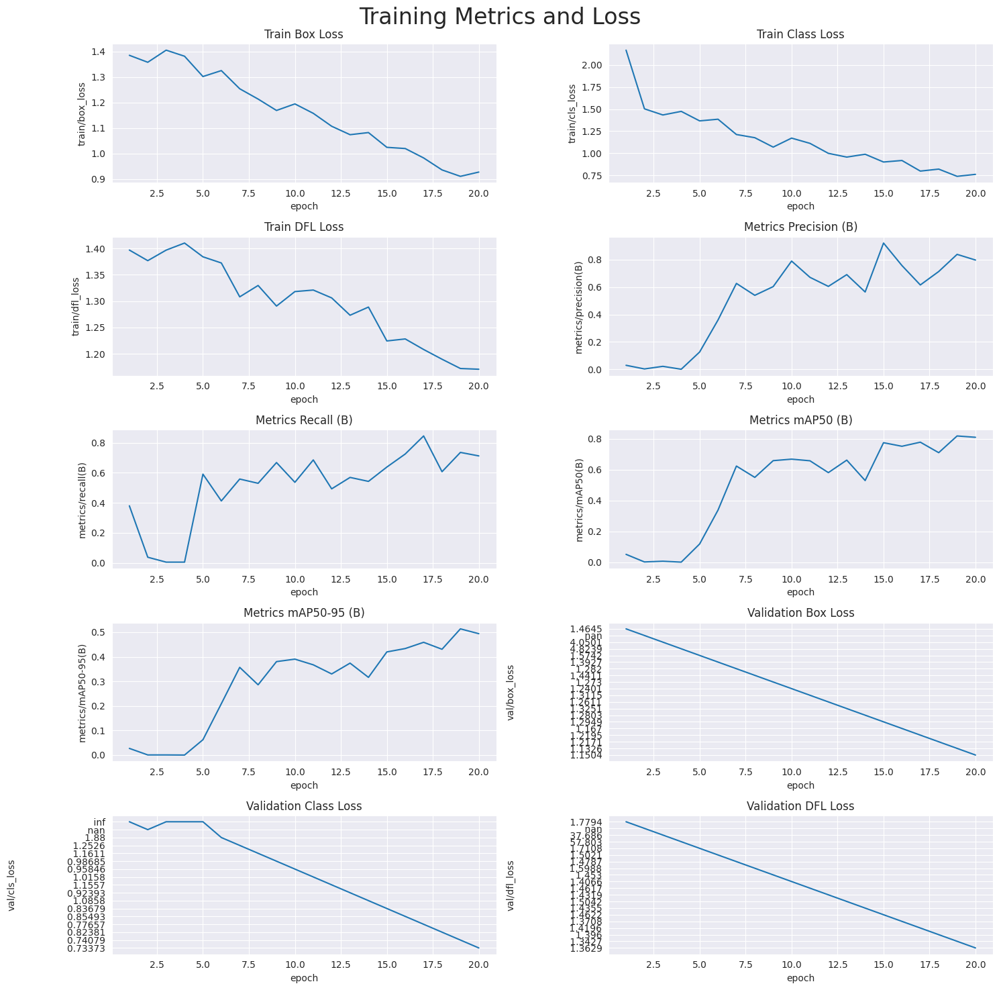

In [26]:
%matplotlib inline
# read in the results.csv file as a pandas dataframe
df = pd.read_csv('/kaggle/working/Storm-Damage-8/bda/runs/detect/train/results.csv')
df.columns = df.columns.str.strip()

# create subplots using seaborn
fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(15, 15))

# plot the columns using seaborn
sns.lineplot(x='epoch', y='train/box_loss', data=df, ax=axs[0,0])
sns.lineplot(x='epoch', y='train/cls_loss', data=df, ax=axs[0,1])
sns.lineplot(x='epoch', y='train/dfl_loss', data=df, ax=axs[1,0])
sns.lineplot(x='epoch', y='metrics/precision(B)', data=df, ax=axs[1,1])
sns.lineplot(x='epoch', y='metrics/recall(B)', data=df, ax=axs[2,0])
sns.lineplot(x='epoch', y='metrics/mAP50(B)', data=df, ax=axs[2,1])
sns.lineplot(x='epoch', y='metrics/mAP50-95(B)', data=df, ax=axs[3,0])
sns.lineplot(x='epoch', y='val/box_loss', data=df, ax=axs[3,1])
sns.lineplot(x='epoch', y='val/cls_loss', data=df, ax=axs[4,0])
sns.lineplot(x='epoch', y='val/dfl_loss', data=df, ax=axs[4,1])

# set titles and axis labels for each subplot
axs[0,0].set(title='Train Box Loss')
axs[0,1].set(title='Train Class Loss')
axs[1,0].set(title='Train DFL Loss')
axs[1,1].set(title='Metrics Precision (B)')
axs[2,0].set(title='Metrics Recall (B)')
axs[2,1].set(title='Metrics mAP50 (B)')
axs[3,0].set(title='Metrics mAP50-95 (B)')
axs[3,1].set(title='Validation Box Loss')
axs[4,0].set(title='Validation Class Loss')
axs[4,1].set(title='Validation DFL Loss')

# add suptitle and subheader
plt.suptitle('Training Metrics and Loss', fontsize=24)

# adjust top margin to make space for suptitle
plt.subplots_adjust(top=0.8)

# adjust spacing between subplots
plt.tight_layout()

plt.show()

In [27]:
bda_model = YOLO(os.path.join(bda_dir, "runs/detect/train/weights/best.pt"))

In [28]:
bda_test_images_dir = os.path.join(bda_dir, "test_bda/images")

# Select one image file from the test set for BDA
bda_test_image_files = os.listdir(bda_test_images_dir)

In [29]:
def predict_and_plot_bda(model, img_path, ax, conf=0.25):
    img = cv2.imread(img_path)
    
    if img is None:
        print(f"Failed to load image: {img_path}")
        return None
    
    detect_result = model(img, conf=conf)
    
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    
    for box in detect_result[0].boxes:
        x_min, y_min, x_max, y_max = box.xyxy[0].tolist()
        conf = box.conf[0].item()
        label = model.names[box.cls[0].item()]
        
        if label == "Damaged":
            color = (1, 1, 0)  # Bright yellow
        else:
            color = (0, 1, 0)  # Bright green
        
        rect = plt.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min, linewidth=1.5, edgecolor=color, facecolor='none')
        ax.add_patch(rect)
        
        ax.text(x_min, y_min, f"{label}: {conf:.2f}", fontsize=10, bbox=dict(facecolor=color, alpha=0.5))
    
    ax.axis('off')
    
    return detect_result


0: 512x512 4 Damageds, 34 Undamageds, 55.9ms
Speed: 4.1ms preprocess, 55.9ms inference, 1.8ms postprocess per image at shape (1, 3, 512, 512)

BDA Predictions (1 image):
Bounding Box: (67.89132690429688, 60.26636505126953), (116.99642944335938, 97.34967803955078), Confidence: 0.92
Bounding Box: (125.46466064453125, 15.175643920898438), (171.11080932617188, 58.757781982421875), Confidence: 0.91
Bounding Box: (190.625244140625, 130.60903930664062), (259.25933837890625, 190.63986206054688), Confidence: 0.90
Bounding Box: (277.54278564453125, 213.48733520507812), (333.53424072265625, 271.6109619140625), Confidence: 0.90
Bounding Box: (320.462646484375, 105.5498275756836), (372.17529296875, 164.22183227539062), Confidence: 0.89
Bounding Box: (283.61273193359375, 168.68402099609375), (333.75030517578125, 219.87896728515625), Confidence: 0.89
Bounding Box: (251.4461669921875, 273.023193359375), (321.79913330078125, 338.6893310546875), Confidence: 0.89
Bounding Box: (227.93637084960938, 56.95

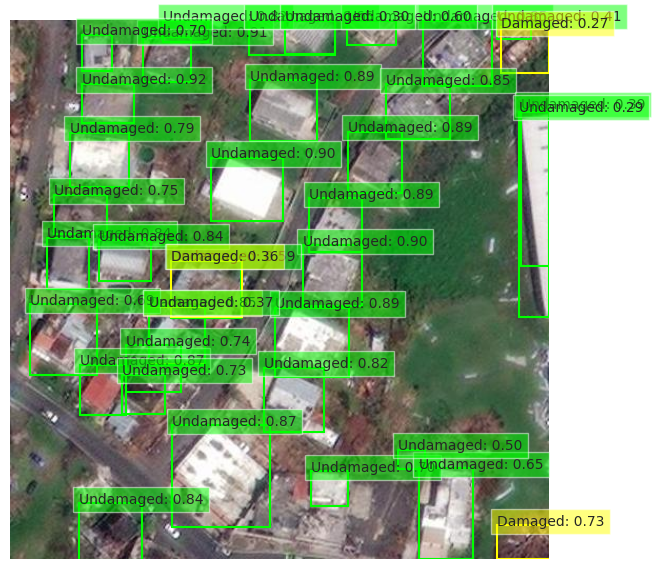

In [31]:
# Select one image file from the BDA test set
bda_image_file = random.choice(bda_test_image_files)
bda_image_path = os.path.join(bda_test_images_dir, bda_image_file)

# Make predictions and get the results
fig, ax = plt.subplots(figsize=(7,7))
bda_result = predict_and_plot_bda(bda_model, bda_image_path, ax)

print("\nBDA Predictions (1 image):")
for box in bda_result[0].boxes:
    x_min, y_min, x_max, y_max = box.xyxy[0].tolist()
    conf = box.conf[0].item()
    print(f"Bounding Box: ({x_min}, {y_min}), ({x_max}, {y_max}), Confidence: {conf:.2f}")

# Predict BTC

In [32]:
def predict_btc(btc_model, img_path, conf=0.25):
    img = cv2.imread(img_path)
    detect_result = btc_model(img, conf=conf)
    detect_img = detect_result[0].plot()
    detect_img = cv2.cvtColor(detect_img, cv2.COLOR_BGR2RGB)
    return detect_img

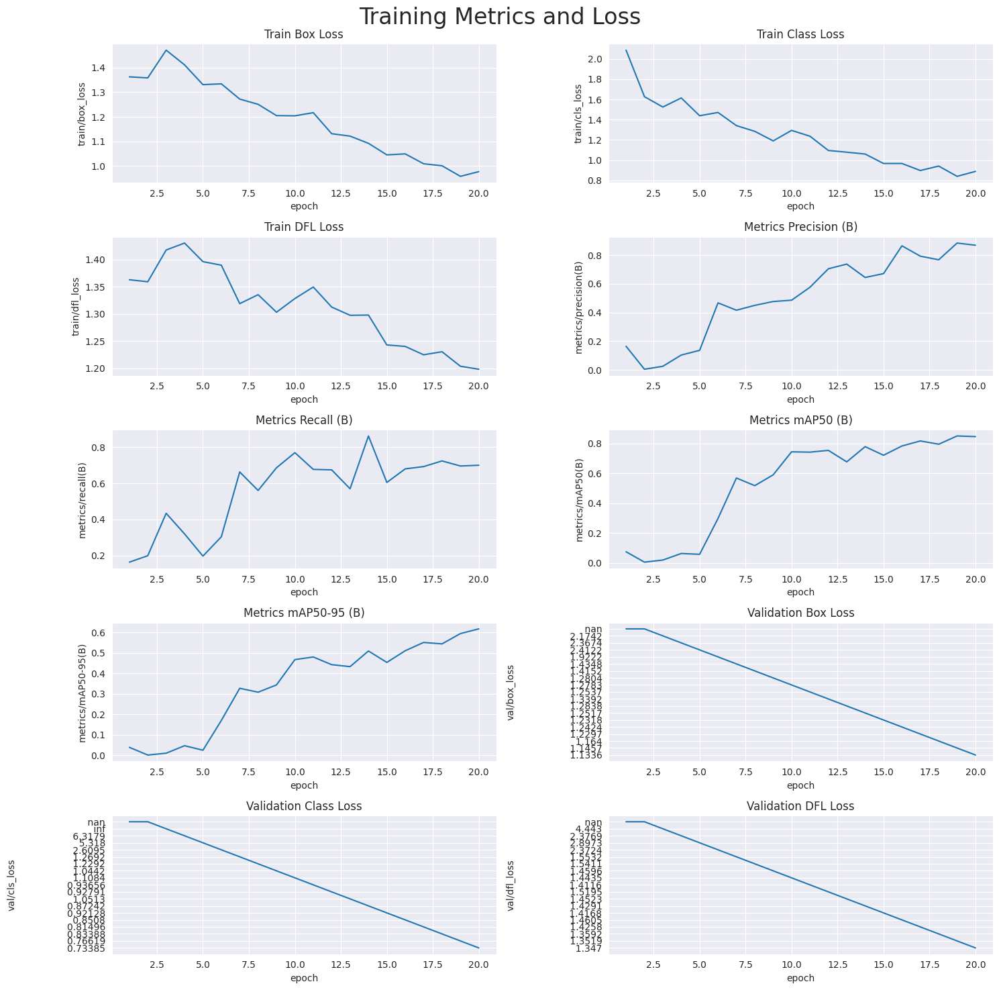

In [33]:
%matplotlib inline
# read in the results.csv file as a pandas dataframe
df = pd.read_csv('/kaggle/working/Storm-Damage-8/btc/runs/detect/train/results.csv')
df.columns = df.columns.str.strip()

# create subplots using seaborn
fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(15, 15))

# plot the columns using seaborn
sns.lineplot(x='epoch', y='train/box_loss', data=df, ax=axs[0,0])
sns.lineplot(x='epoch', y='train/cls_loss', data=df, ax=axs[0,1])
sns.lineplot(x='epoch', y='train/dfl_loss', data=df, ax=axs[1,0])
sns.lineplot(x='epoch', y='metrics/precision(B)', data=df, ax=axs[1,1])
sns.lineplot(x='epoch', y='metrics/recall(B)', data=df, ax=axs[2,0])
sns.lineplot(x='epoch', y='metrics/mAP50(B)', data=df, ax=axs[2,1])
sns.lineplot(x='epoch', y='metrics/mAP50-95(B)', data=df, ax=axs[3,0])
sns.lineplot(x='epoch', y='val/box_loss', data=df, ax=axs[3,1])
sns.lineplot(x='epoch', y='val/cls_loss', data=df, ax=axs[4,0])
sns.lineplot(x='epoch', y='val/dfl_loss', data=df, ax=axs[4,1])

# set titles and axis labels for each subplot
axs[0,0].set(title='Train Box Loss')
axs[0,1].set(title='Train Class Loss')
axs[1,0].set(title='Train DFL Loss')
axs[1,1].set(title='Metrics Precision (B)')
axs[2,0].set(title='Metrics Recall (B)')
axs[2,1].set(title='Metrics mAP50 (B)')
axs[3,0].set(title='Metrics mAP50-95 (B)')
axs[3,1].set(title='Validation Box Loss')
axs[4,0].set(title='Validation Class Loss')
axs[4,1].set(title='Validation DFL Loss')

# add suptitle and subheader
plt.suptitle('Training Metrics and Loss', fontsize=24)

# adjust top margin to make space for suptitle
plt.subplots_adjust(top=0.8)

# adjust spacing between subplots
plt.tight_layout()

plt.show()

In [34]:
btc_model = YOLO(os.path.join(btc_dir, "runs/detect/train/weights/best.pt"))

In [35]:
btc_test_images_dir = os.path.join(btc_dir, "test_btc/images")

# Select one image file from the test set for BDA
btc_test_image_files = os.listdir(btc_test_images_dir)

In [36]:
def predict_and_plot_btc(model, img_path, ax, conf=0.25):
    img = cv2.imread(img_path)
    
    if img is None:
        print(f"Failed to load image: {img_path}")
        return None
    
    detect_result = model(img, conf=conf)
    
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    
    for box in detect_result[0].boxes:
        x_min, y_min, x_max, y_max = box.xyxy[0].tolist()
        conf = box.conf[0].item()
        label = model.names[box.cls[0].item()]
        
        if label == "Commercial":
            color = (1, 1, 0) 
        else:
            color = (0, 1, 0)  
        
        rect = plt.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min, linewidth=1.5, edgecolor=color, facecolor='none')
        ax.add_patch(rect)
        
        ax.text(x_min, y_min, f"{label}: {conf:.2f}", fontsize=10, bbox=dict(facecolor=color, alpha=0.5))
    
    ax.axis('off')
    
    return detect_result


0: 512x512 1 Commercial, 17 Residentials, 55.7ms
Speed: 1.7ms preprocess, 55.7ms inference, 2.3ms postprocess per image at shape (1, 3, 512, 512)

BTC Predictions (1 image):
Bounding Box: (341.56256103515625, 107.0435562133789), (394.57879638671875, 165.28347778320312), Confidence: 0.88
Bounding Box: (330.87701416015625, 52.02653121948242), (377.42694091796875, 93.98820495605469), Confidence: 0.87
Bounding Box: (211.87841796875, 89.33221435546875), (264.9092712402344, 154.7880859375), Confidence: 0.87
Bounding Box: (255.5623779296875, 0.0), (309.55950927734375, 39.699310302734375), Confidence: 0.82
Bounding Box: (169.2052764892578, 0.0), (218.8837127685547, 24.55710220336914), Confidence: 0.76
Bounding Box: (281.94317626953125, 457.3722229003906), (337.62567138671875, 511.7984313964844), Confidence: 0.75
Bounding Box: (94.31997680664062, 0.1491680145263672), (135.7620086669922, 29.616928100585938), Confidence: 0.68
Bounding Box: (498.33575439453125, 47.70337677001953), (511.7727050781

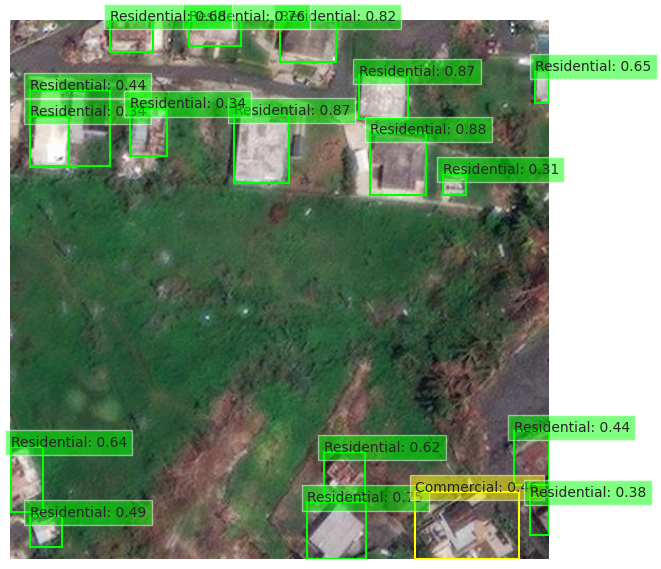

In [38]:
# Select one image file from the BTC test set
btc_image_file = random.choice(btc_test_image_files)
btc_image_path = os.path.join(btc_test_images_dir, btc_image_file)

# Make predictions and get the results
fig, ax = plt.subplots(figsize=(7,7))
btc_result = predict_and_plot_btc(btc_model, btc_image_path, ax)

print("\nBTC Predictions (1 image):")
for box in btc_result[0].boxes:
    x_min, y_min, x_max, y_max = box.xyxy[0].tolist()
    conf = box.conf[0].item()
    print(f"Bounding Box: ({x_min}, {y_min}), ({x_max}, {y_max}), Confidence: {conf:.2f}")

# Sequential Processing

In [39]:
dataset_dir = "/kaggle/working/Storm-Damage-8/"
test_images_dir = os.path.join(dataset_dir, "test/images")
test_labels_dir = os.path.join(dataset_dir, "test/labels")
test_image_files = os.listdir(test_images_dir)

In [40]:
def calculate_iou(boxA, boxB):
    xA = max(boxA['x_min'], boxB['x_min'])
    yA = max(boxA['y_min'], boxB['y_min'])
    xB = min(boxA['x_max'], boxB['x_max'])
    yB = min(boxA['y_max'], boxB['y_max'])
    interArea = max(0, xB - xA) * max(0, yB - yA)
    if interArea == 0:
        return 0
    boxAArea = (boxA['x_max'] - boxA['x_min']) * (boxA['y_max'] - boxA['y_min'])
    boxBArea = (boxB['x_max'] - boxB['x_min']) * (boxB['y_max'] - boxB['y_min'])
    iou = interArea / float(boxAArea + boxBArea - interArea)
    return iou

In [41]:
def merge_predictions(bda_predictions, btc_predictions, iou_threshold=0.65):
    merged_predictions = []
    used_btc_predictions = []

    for bda in bda_predictions:
        max_iou = 0
        max_btc = None
        for btc in btc_predictions:
            iou = calculate_iou(bda, btc)
            if iou >= iou_threshold and iou > max_iou:
                max_iou = iou
                max_btc = btc

        if max_btc is not None:
            merged_class = f"{bda['class_name']} {max_btc['class_name']}"
            merged_predictions.append({
                **bda,
                'class_name': merged_class,
                'confidence': (bda['confidence'] + max_btc['confidence']) / 2
            })
            used_btc_predictions.append(max_btc)

    return merged_predictions

In [42]:
def predict_merged(merged_predictions, img_path):
    img = cv2.imread(img_path)
    font = cv2.FONT_HERSHEY_SIMPLEX
    font_scale = 0.6
    font_thickness = 2

    for pred in merged_predictions:
        if pred['image_path'] == img_path:
            x_min, y_min, x_max, y_max = map(int, [pred['x_min'], pred['y_min'], pred['x_max'], pred['y_max']])
            class_name = pred['class_name']

            # Draw bounding box
            cv2.rectangle(img, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)

            # Calculate text size for background rectangle
            text_size = cv2.getTextSize(class_name, font, font_scale, font_thickness)[0]
            text_width, text_height = text_size[0], text_size[1]
            rect_top_left = (x_min, y_min - text_height - 4)
            rect_bottom_right = (x_min + text_width, y_min)

            # Prepare overlay for semi-transparent background
            overlay = img.copy()
            cv2.rectangle(overlay, rect_top_left, rect_bottom_right, (0, 0, 0), -1)

            # Apply the overlay with transparency
            alpha = 0.5  # Transparency factor (between 0 and 1)
            cv2.addWeighted(overlay, alpha, img, 1 - alpha, 0, img)

            # Put white text on the semi-transparent background
            cv2.putText(img, class_name, (x_min, y_min - 2), font, font_scale, (255, 255, 255), font_thickness)

    return img


image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_005_jpg.rf.16fbe675bcc26043e87d0c943f3a669f.jpg: 512x512 2 Damageds, 30 Undamageds, 55.8ms
Speed: 1.7ms preprocess, 55.8ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 512)

image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_005_jpg.rf.16fbe675bcc26043e87d0c943f3a669f.jpg: 512x512 30 Residentials, 55.6ms
Speed: 1.0ms preprocess, 55.6ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 2 Damageds, 30 Undamageds, 42.1ms
Speed: 1.5ms preprocess, 42.1ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 30 Residentials, 41.8ms
Speed: 1.4ms preprocess, 41.8ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 512)


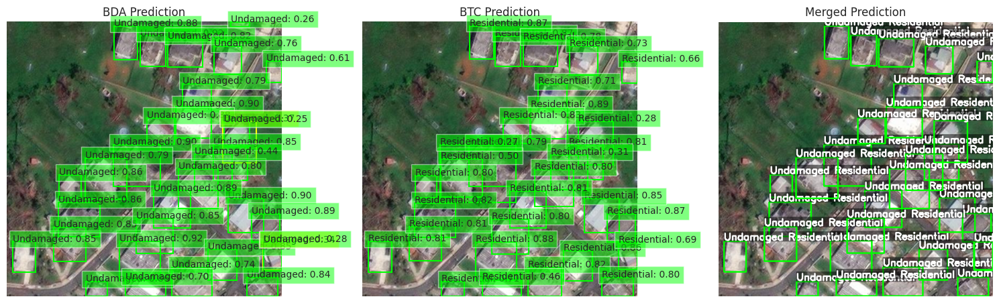


image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_010_jpg.rf.7a1e71f63203336004fb83f295d2d68c.jpg: 512x512 4 Damageds, 16 Undamageds, 41.8ms
Speed: 2.4ms preprocess, 41.8ms inference, 1.8ms postprocess per image at shape (1, 3, 512, 512)

image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_010_jpg.rf.7a1e71f63203336004fb83f295d2d68c.jpg: 512x512 5 Commercials, 12 Residentials, 41.6ms
Speed: 1.0ms preprocess, 41.6ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 4 Damageds, 16 Undamageds, 41.6ms
Speed: 1.2ms preprocess, 41.6ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 5 Commercials, 12 Residentials, 32.6ms
Speed: 1.4ms preprocess, 32.6ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 512)


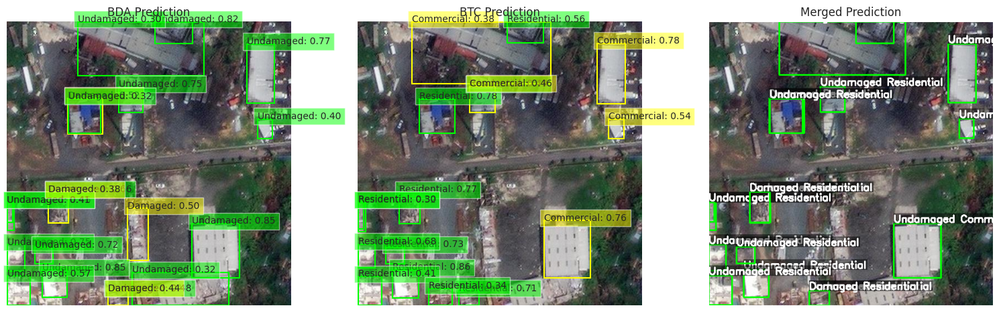


image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_008_jpg.rf.e6b055d22aecf62e2e7586c74c490bfa.jpg: 512x512 5 Damageds, 13 Undamageds, 32.0ms
Speed: 1.5ms preprocess, 32.0ms inference, 1.8ms postprocess per image at shape (1, 3, 512, 512)

image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_008_jpg.rf.e6b055d22aecf62e2e7586c74c490bfa.jpg: 512x512 1 Commercial, 17 Residentials, 33.0ms
Speed: 1.1ms preprocess, 33.0ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 5 Damageds, 13 Undamageds, 32.4ms
Speed: 1.5ms preprocess, 32.4ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 1 Commercial, 17 Residentials, 30.0ms
Speed: 1.7ms preprocess, 30.0ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 512)


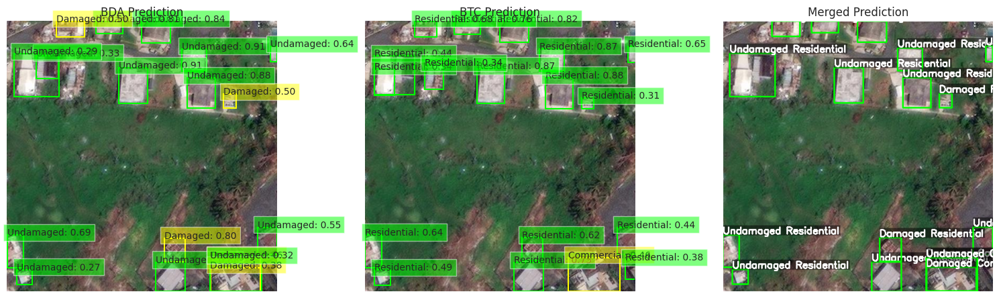


image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_004_jpg.rf.5142f9faf5064f99e4c64d5a681d66ab.jpg: 512x512 1 Damaged, 12 Undamageds, 30.1ms
Speed: 1.9ms preprocess, 30.1ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 512)

image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_004_jpg.rf.5142f9faf5064f99e4c64d5a681d66ab.jpg: 512x512 1 Commercial, 14 Residentials, 34.3ms
Speed: 1.1ms preprocess, 34.3ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 1 Damaged, 12 Undamageds, 30.8ms
Speed: 2.0ms preprocess, 30.8ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 1 Commercial, 14 Residentials, 30.1ms
Speed: 1.5ms preprocess, 30.1ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 512)


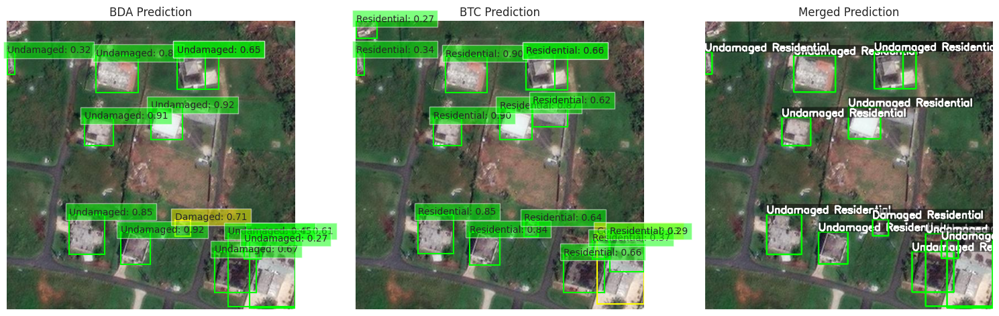


image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_006_jpg.rf.88608a75718bc934f0856d405760224d.jpg: 512x512 4 Damageds, 34 Undamageds, 44.5ms
Speed: 2.4ms preprocess, 44.5ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 512)

image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_006_jpg.rf.88608a75718bc934f0856d405760224d.jpg: 512x512 1 Commercial, 32 Residentials, 45.5ms
Speed: 1.1ms preprocess, 45.5ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 4 Damageds, 34 Undamageds, 42.3ms
Speed: 1.8ms preprocess, 42.3ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 1 Commercial, 32 Residentials, 34.9ms
Speed: 1.5ms preprocess, 34.9ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 512)


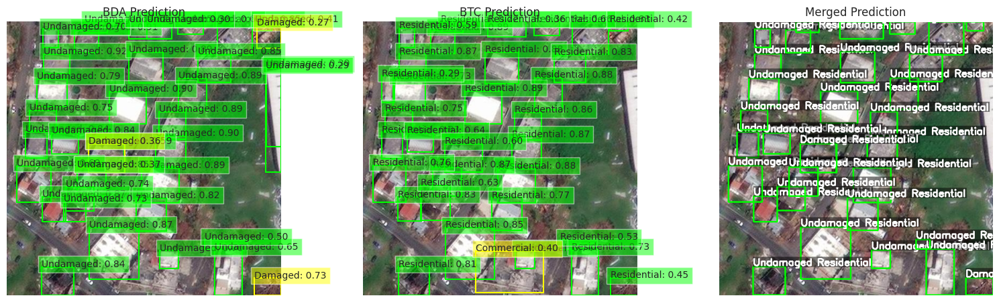


image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_007_jpg.rf.0b7db81c392e6480ac2cb4ec8348899d.jpg: 512x512 2 Damageds, 32 Undamageds, 34.3ms
Speed: 1.6ms preprocess, 34.3ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 512)

image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_007_jpg.rf.0b7db81c392e6480ac2cb4ec8348899d.jpg: 512x512 1 Commercial, 36 Residentials, 35.6ms
Speed: 1.3ms preprocess, 35.6ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 2 Damageds, 32 Undamageds, 35.0ms
Speed: 1.5ms preprocess, 35.0ms inference, 1.4ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 1 Commercial, 36 Residentials, 34.3ms
Speed: 1.3ms preprocess, 34.3ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 512)


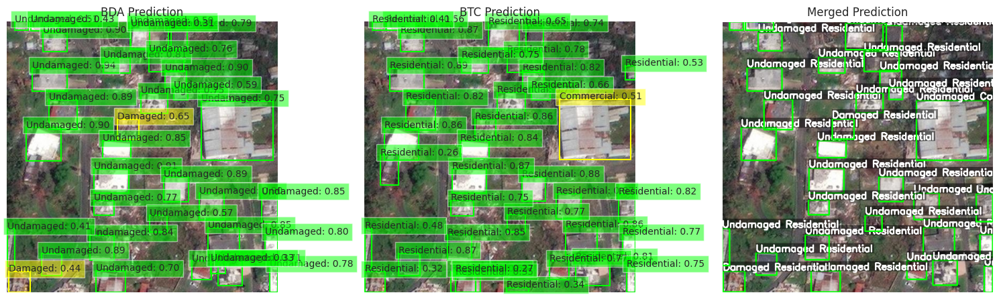


image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_009_jpg.rf.ea40d1c007170898659af43bd1ebd4dd.jpg: 512x512 1 Damaged, 21 Undamageds, 49.5ms
Speed: 2.1ms preprocess, 49.5ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 512)

image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_009_jpg.rf.ea40d1c007170898659af43bd1ebd4dd.jpg: 512x512 2 Commercials, 21 Residentials, 49.1ms
Speed: 1.1ms preprocess, 49.1ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 1 Damaged, 21 Undamageds, 42.1ms
Speed: 1.9ms preprocess, 42.1ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 2 Commercials, 21 Residentials, 40.6ms
Speed: 1.4ms preprocess, 40.6ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 512)


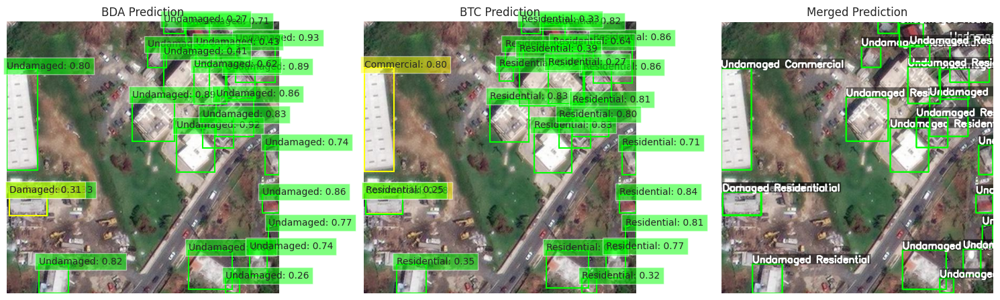


image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_001.rf.e8fd1fe84d2a38d881a2ca281853819b.jpg: 512x512 3 Damageds, 32 Undamageds, 39.2ms
Speed: 1.5ms preprocess, 39.2ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 512)

image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_001.rf.e8fd1fe84d2a38d881a2ca281853819b.jpg: 512x512 32 Residentials, 39.0ms
Speed: 1.1ms preprocess, 39.0ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 3 Damageds, 32 Undamageds, 37.3ms
Speed: 1.8ms preprocess, 37.3ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 32 Residentials, 33.9ms
Speed: 1.4ms preprocess, 33.9ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 512)


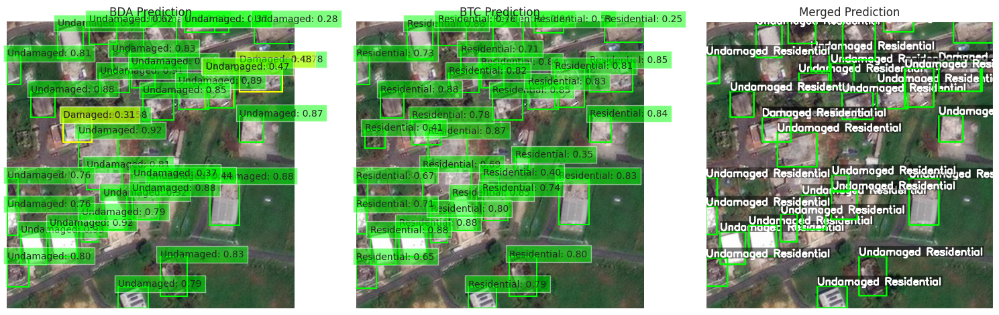


image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_012_jpg.rf.576edf4d2c34a2bc4ff0bbc74831075d.jpg: 512x512 1 Damaged, 28 Undamageds, 33.2ms
Speed: 2.2ms preprocess, 33.2ms inference, 1.8ms postprocess per image at shape (1, 3, 512, 512)

image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_012_jpg.rf.576edf4d2c34a2bc4ff0bbc74831075d.jpg: 512x512 2 Commercials, 29 Residentials, 35.8ms
Speed: 1.1ms preprocess, 35.8ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 1 Damaged, 28 Undamageds, 34.4ms
Speed: 2.0ms preprocess, 34.4ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 2 Commercials, 29 Residentials, 34.3ms
Speed: 1.5ms preprocess, 34.3ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 512)


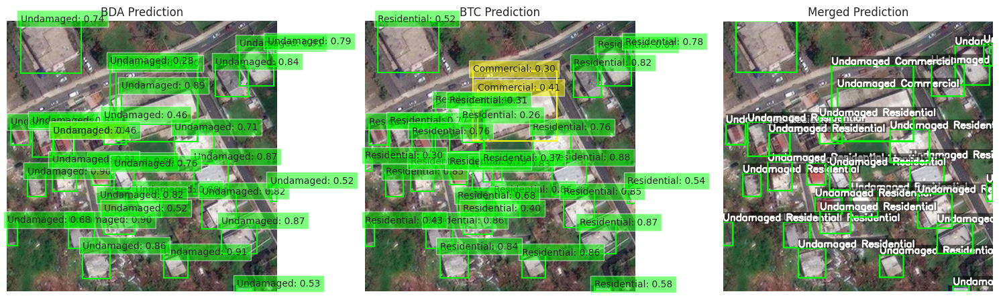


image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_011_jpg.rf.727d63e0af0282774a37ef0f06331784.jpg: 512x512 1 Damaged, 18 Undamageds, 50.4ms
Speed: 1.3ms preprocess, 50.4ms inference, 1.8ms postprocess per image at shape (1, 3, 512, 512)

image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_011_jpg.rf.727d63e0af0282774a37ef0f06331784.jpg: 512x512 4 Commercials, 10 Residentials, 50.0ms
Speed: 1.1ms preprocess, 50.0ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 1 Damaged, 18 Undamageds, 41.9ms
Speed: 1.4ms preprocess, 41.9ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 4 Commercials, 10 Residentials, 39.8ms
Speed: 1.5ms preprocess, 39.8ms inference, 1.4ms postprocess per image at shape (1, 3, 512, 512)


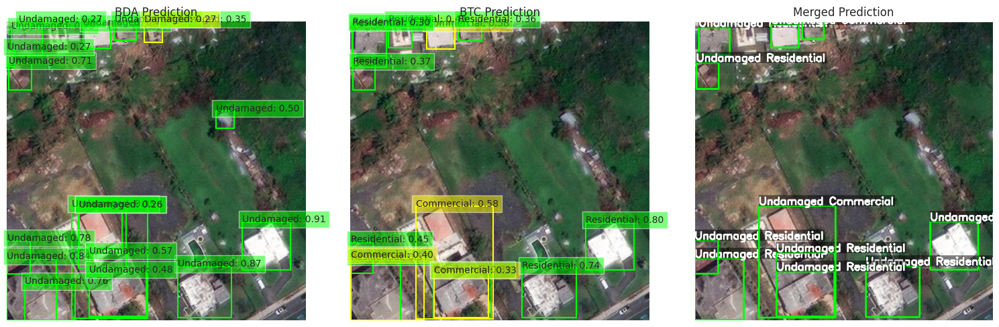


image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_003_jpg.rf.2270c6415449a627bb9f5c122bd7c484.jpg: 512x512 5 Damageds, 11 Undamageds, 39.2ms
Speed: 1.2ms preprocess, 39.2ms inference, 1.8ms postprocess per image at shape (1, 3, 512, 512)

image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_003_jpg.rf.2270c6415449a627bb9f5c122bd7c484.jpg: 512x512 15 Residentials, 39.1ms
Speed: 1.1ms preprocess, 39.1ms inference, 1.4ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 5 Damageds, 11 Undamageds, 39.3ms
Speed: 1.9ms preprocess, 39.3ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 15 Residentials, 35.6ms
Speed: 1.6ms preprocess, 35.6ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 512)


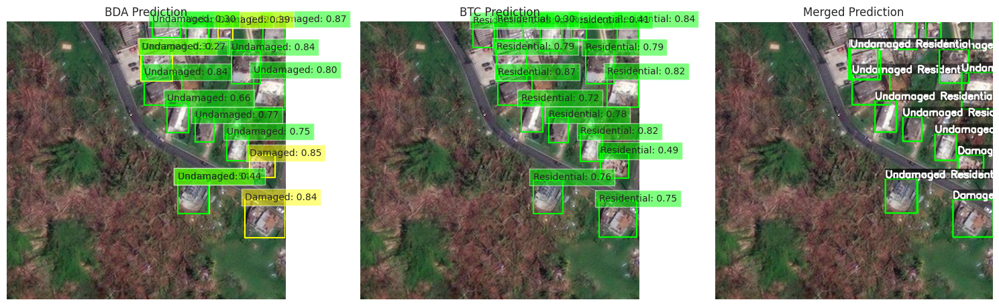


image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_002_jpg.rf.6a5c87deaca79e80f53cf5b5e2cb0569.jpg: 512x512 2 Damageds, 10 Undamageds, 34.7ms
Speed: 1.2ms preprocess, 34.7ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 512)

image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_002_jpg.rf.6a5c87deaca79e80f53cf5b5e2cb0569.jpg: 512x512 16 Residentials, 34.5ms
Speed: 1.2ms preprocess, 34.5ms inference, 1.4ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 2 Damageds, 10 Undamageds, 35.6ms
Speed: 1.4ms preprocess, 35.6ms inference, 1.4ms postprocess per image at shape (1, 3, 512, 512)

0: 512x512 16 Residentials, 33.2ms
Speed: 1.3ms preprocess, 33.2ms inference, 1.4ms postprocess per image at shape (1, 3, 512, 512)


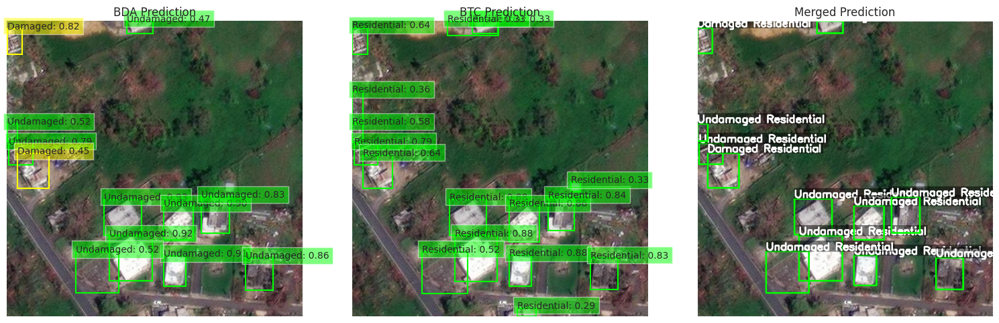

In [43]:
for img_file in test_image_files:
    img_path = os.path.join(test_images_dir, img_file)

    bda_predictions = []
    btc_predictions = []

    bda_result = bda_model(img_path)[0]
    btc_result = btc_model(img_path)[0]

    for box in bda_result.boxes:
        if box.cls.size(0) > 0:
            bda_predictions.append({
                'image_path': img_path,
                'x_min': box.xyxy[0][0].item(),
                'y_min': box.xyxy[0][1].item(),
                'x_max': box.xyxy[0][2].item(),
                'y_max': box.xyxy[0][3].item(),
                'class_name': bda_result.names[box.cls[0].item()],
                'confidence': box.conf[0].item()
            })

    for box in btc_result.boxes:
        if box.cls.size(0) > 0:
            btc_predictions.append({
                'image_path': img_path,
                'x_min': box.xyxy[0][0].item(),
                'y_min': box.xyxy[0][1].item(),
                'x_max': box.xyxy[0][2].item(),
                'y_max': box.xyxy[0][3].item(),
                'class_name': btc_result.names[box.cls[0].item()],
                'confidence': box.conf[0].item()
            })
            
    # Merge results of BDA and BTC predictions
    merged_predictions = merge_predictions(bda_predictions, btc_predictions)

    fig, axs = plt.subplots(1, 3, figsize=(15, 10))

    # BDA Prediction
    predict_and_plot_bda(bda_model, img_path, axs[0])
    axs[0].set_title("BDA Prediction")
    axs[0].grid(False)
    axs[0].set_xticks([])
    axs[0].set_yticks([])

    # BTC Prediction
    predict_and_plot_btc(btc_model, img_path, axs[1])
    axs[1].set_title("BTC Prediction")
    axs[1].grid(False)
    axs[1].set_xticks([])
    axs[1].set_yticks([])

    # Merged Prediction
    merge_img = predict_merged(merged_predictions, img_path)
    axs[2].imshow(cv2.cvtColor(merge_img, cv2.COLOR_BGR2RGB))
    axs[2].set_title("Merged Prediction")
    axs[2].grid(False)
    axs[2].set_xticks([])
    axs[2].set_yticks([])

    plt.tight_layout()
    plt.show()

# Evaluate

In [49]:
import matplotlib.patches as patches

In [44]:
def convert_polygons_to_bounding_boxes(dataset_dir, test_images_dir, test_labels_dir, output_dir):
    label_files = os.listdir(test_labels_dir)
    os.makedirs(output_dir, exist_ok=True)

    for label_file in label_files:
        with open(os.path.join(test_labels_dir, label_file), 'r') as file:
            lines = file.readlines()

        new_lines = []
        for line in lines:
            parts = line.strip().split()
            class_id = parts[0]  
            points = list(map(float, parts[1:]))  
            
            xs = points[0::2]
            ys = points[1::2]
            x_min = min(xs)
            x_max = max(xs)
            y_min = min(ys)
            y_max = max(ys)
            
            new_lines.append(f"{class_id} {x_min} {y_min} {x_max} {y_max}\n")

        with open(os.path.join(output_dir, label_file), 'w') as file:
            file.writelines(new_lines)

In [121]:
def visualize_bounding_boxes(dataset_dir, output_dir, bda_predictions, btc_predictions, merged_predictions, img_path):
    image_file = os.path.basename(img_path)
    label_path = os.path.join(output_dir, os.path.splitext(image_file)[0] + '.txt')
    
    img = Image.open(img_path)
    img_width, img_height = img.size
    fig, axs = plt.subplots(1, 2, figsize=(10, 8))
    
    # Visualize merged predicted bounding boxes
    axs[0].imshow(img)
    axs[0].set_title("Merged Prediction", fontweight='bold', fontsize=14)
    for pred in merged_predictions:
        if pred['image_path'] == img_path:
            x_min, y_min, x_max, y_max = map(int, [pred['x_min'], pred['y_min'], pred['x_max'], pred['y_max']])
            class_name = pred['class_name']
            
            if class_name == "Damaged Commercial":
                class_id = 0
            elif class_name == "Damaged Residential":
                class_id = 1
            elif class_name == "Undamaged Commercial":
                class_id = 2
            else:  # "Undamaged Residential"
                class_id = 3
            
            rect = patches.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min, linewidth=1.5, edgecolor='orange', facecolor='none')
            axs[0].add_patch(rect)
            axs[0].text(x_min, y_min - 10, str(class_id), color='white', fontsize=10, bbox=dict(facecolor='orange', alpha=0.5))
    
    # Visualize ground truth bounding boxes
    axs[1].imshow(img)
    axs[1].set_title("Ground Truth", fontweight='bold', fontsize=14)
    if os.path.exists(label_path):
        with open(label_path, 'r') as file:
            lines = file.readlines()
            for line in lines:
                parts = line.strip().split()
                class_id = int(parts[0])
                x_min, y_min, x_max, y_max = map(float, parts[1:])
                
                x_min *= img_width
                x_max *= img_width
                y_min *= img_height
                y_max *= img_height
                
                width = x_max - x_min
                height = y_max - y_min
                
                rect = patches.Rectangle((x_min, y_min), width, height, linewidth=1.5, edgecolor='red', facecolor='none')
                axs[1].add_patch(rect)
                axs[1].text(x_min, y_min - 10, str(class_id), color='white', fontsize=10, bbox=dict(facecolor='red', alpha=0.5))
    
    for ax in axs:
        ax.axis('off')
    plt.tight_layout()
    plt.show()

In [107]:
def calculate_iou(boxA, boxB):
    xA = max(boxA['x_min'], boxB['x_min'])
    yA = max(boxA['y_min'], boxB['y_min'])
    xB = min(boxA['x_max'], boxB['x_max'])
    yB = min(boxA['y_max'], boxB['y_max'])

    interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)

    boxAArea = (boxA['x_max'] - boxA['x_min'] + 1) * (boxA['y_max'] - boxA['y_min'] + 1)
    boxBArea = (boxB['x_max'] - boxB['x_min'] + 1) * (boxB['y_max'] - boxB['y_min'] + 1)

    iou = interArea / float(boxAArea + boxBArea - interArea)

    return iou

In [115]:
def load_ground_truth(image_path, labels_dir):
    label_path = os.path.join(labels_dir, os.path.splitext(os.path.basename(image_path))[0] + ".txt")
    ground_truth = []
    with open(label_path, "r") as file:
        for line in file:
            line = line.strip().split()
            class_id = int(line[0])
            if class_id == 0:
                class_name = "Damaged Commercial Building"
            elif class_id == 1:
                class_name = "Damaged Residential Building"
            elif class_id == 2:
                class_name = "Undamaged Commercial Building"
            else:
                class_name = "Undamaged Residential Building"
            
            coordinates = list(map(float, line[1:]))
            if len(coordinates) >= 4:
                x_min = min(coordinates[0::2])
                x_max = max(coordinates[0::2])
                y_min = min(coordinates[1::2])
                y_max = max(coordinates[1::2])
            else:
                continue 
            
            ground_truth.append({
                "class_name": class_name,
                "x_min": x_min,
                "y_min": y_min,
                "x_max": x_max,
                "y_max": y_max
            })
    return ground_truth

In [116]:
def calculate_metrics(merged_predictions, ground_truth, image_width=512, image_height=512, iou_threshold=0.5):
    true_positives = 0
    false_positives = 0
    false_negatives = 0

    for gt_box in ground_truth:
        matched = False
        gt_class_name = gt_box["class_name"].replace("Building", "").strip()
        gt_x_min = gt_box["x_min"] * image_width
        gt_y_min = gt_box["y_min"] * image_height
        gt_x_max = gt_box["x_max"] * image_width
        gt_y_max = gt_box["y_max"] * image_height
        
        for pred_box in merged_predictions:
            pred_class_name = pred_box["class_name"].replace("Building", "").strip()
            pred_x_min = pred_box["x_min"]
            pred_y_min = pred_box["y_min"]
            pred_x_max = pred_box["x_max"]
            pred_y_max = pred_box["y_max"]
            
            iou = calculate_iou(
                {"x_min": gt_x_min, "y_min": gt_y_min, "x_max": gt_x_max, "y_max": gt_y_max},
                {"x_min": pred_x_min, "y_min": pred_y_min, "x_max": pred_x_max, "y_max": pred_y_max}
            )
            
            if iou >= iou_threshold and gt_class_name == pred_class_name:
                true_positives += 1
                matched = True
                break
        
        if not matched:
            false_negatives += 1

    false_positives = len(merged_predictions) - true_positives

    precision = true_positives / (true_positives + false_positives) if true_positives + false_positives > 0 else 0
    recall = true_positives / (true_positives + false_negatives) if true_positives + false_negatives > 0 else 0
    f1_score = 2 * (precision * recall) / (precision + recall) if precision + recall > 0 else 0

    return precision, recall, f1_score

### Labels:
#### 0: Damaged Commercial
#### 1: Damaged Residential
#### 2: Undamaged Commercial
#### 3: Undamaged Residential


image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_005_jpg.rf.16fbe675bcc26043e87d0c943f3a669f.jpg: 512x512 2 Damageds, 30 Undamageds, 55.7ms
Speed: 1.7ms preprocess, 55.7ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 512)

image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_005_jpg.rf.16fbe675bcc26043e87d0c943f3a669f.jpg: 512x512 30 Residentials, 55.6ms
Speed: 1.0ms preprocess, 55.6ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 512)


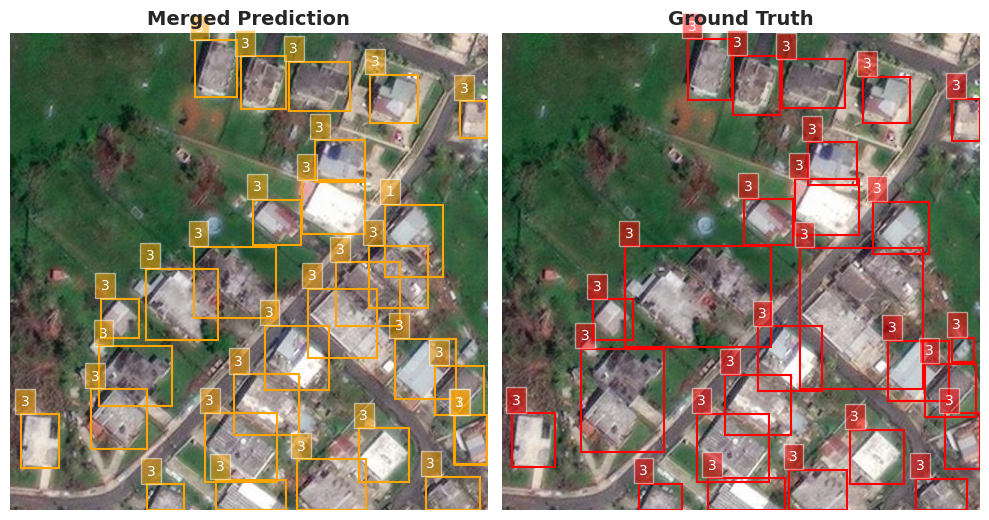


image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_010_jpg.rf.7a1e71f63203336004fb83f295d2d68c.jpg: 512x512 4 Damageds, 16 Undamageds, 55.8ms
Speed: 1.4ms preprocess, 55.8ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 512)

image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_010_jpg.rf.7a1e71f63203336004fb83f295d2d68c.jpg: 512x512 5 Commercials, 12 Residentials, 55.6ms
Speed: 1.1ms preprocess, 55.6ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 512)


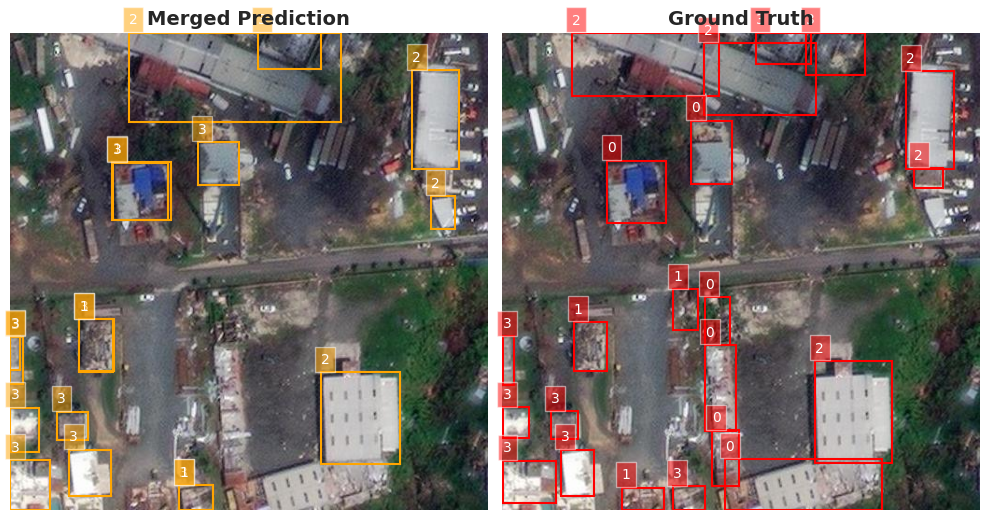


image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_008_jpg.rf.e6b055d22aecf62e2e7586c74c490bfa.jpg: 512x512 5 Damageds, 13 Undamageds, 50.5ms
Speed: 1.6ms preprocess, 50.5ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 512)

image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_008_jpg.rf.e6b055d22aecf62e2e7586c74c490bfa.jpg: 512x512 1 Commercial, 17 Residentials, 50.3ms
Speed: 1.0ms preprocess, 50.3ms inference, 1.8ms postprocess per image at shape (1, 3, 512, 512)


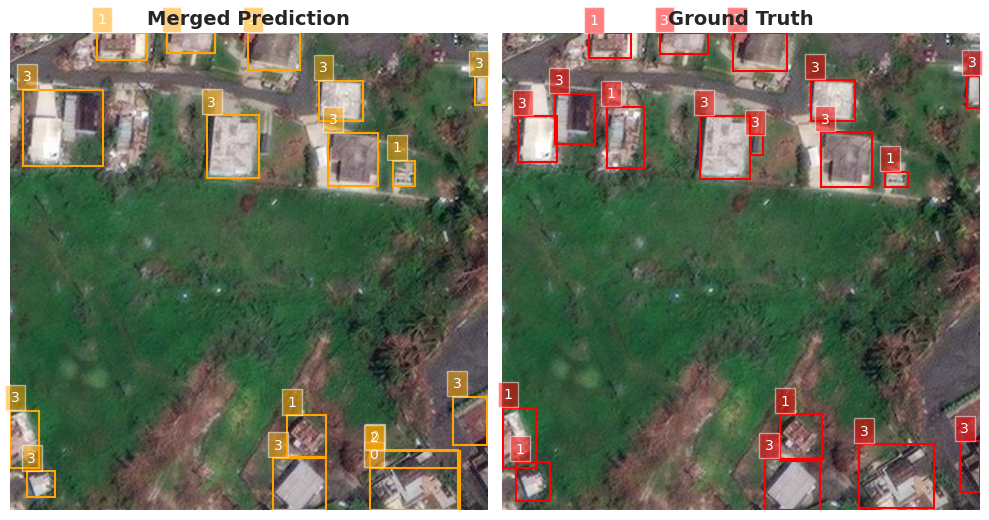


image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_004_jpg.rf.5142f9faf5064f99e4c64d5a681d66ab.jpg: 512x512 1 Damaged, 12 Undamageds, 41.3ms
Speed: 1.6ms preprocess, 41.3ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 512)

image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_004_jpg.rf.5142f9faf5064f99e4c64d5a681d66ab.jpg: 512x512 1 Commercial, 14 Residentials, 41.1ms
Speed: 1.0ms preprocess, 41.1ms inference, 1.4ms postprocess per image at shape (1, 3, 512, 512)


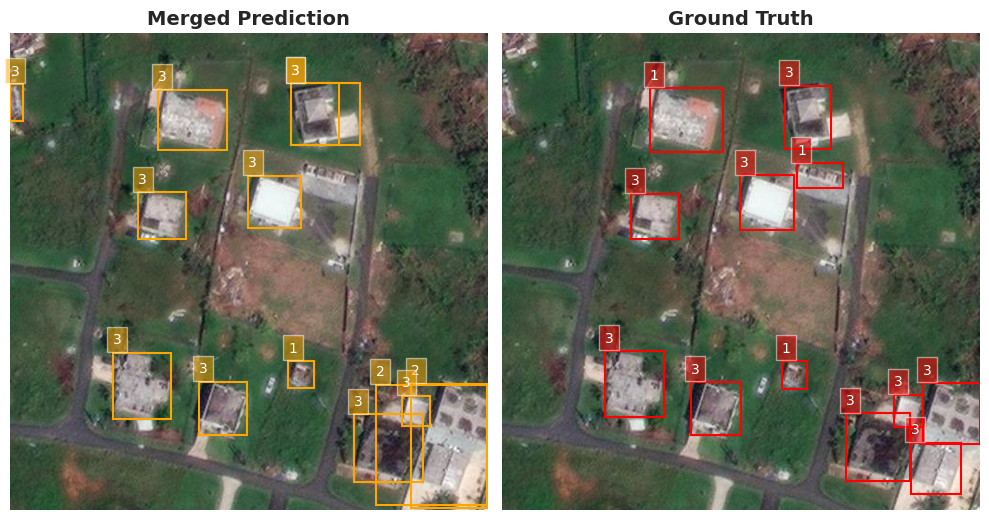


image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_006_jpg.rf.88608a75718bc934f0856d405760224d.jpg: 512x512 4 Damageds, 34 Undamageds, 55.8ms
Speed: 1.2ms preprocess, 55.8ms inference, 2.0ms postprocess per image at shape (1, 3, 512, 512)

image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_006_jpg.rf.88608a75718bc934f0856d405760224d.jpg: 512x512 1 Commercial, 32 Residentials, 54.7ms
Speed: 1.1ms preprocess, 54.7ms inference, 2.4ms postprocess per image at shape (1, 3, 512, 512)


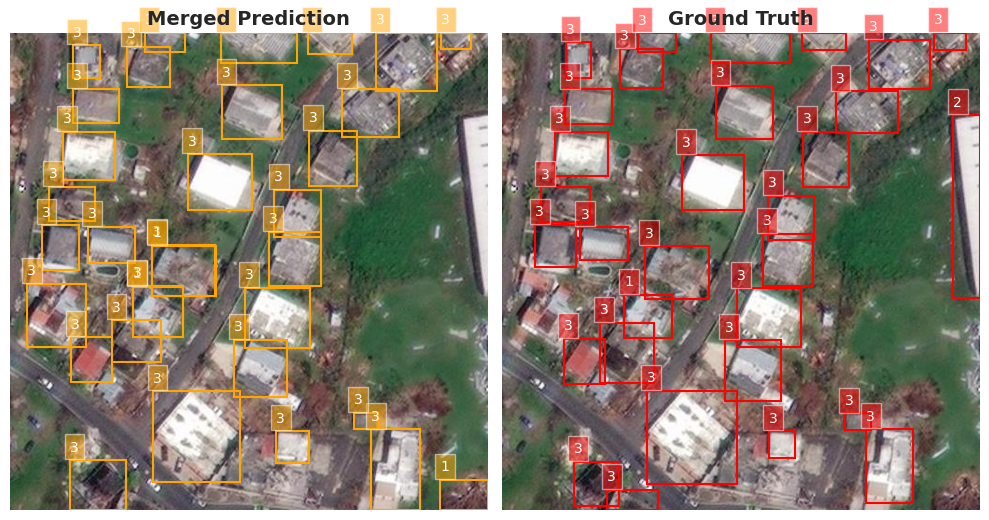


image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_007_jpg.rf.0b7db81c392e6480ac2cb4ec8348899d.jpg: 512x512 2 Damageds, 32 Undamageds, 52.4ms
Speed: 1.2ms preprocess, 52.4ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 512)

image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_007_jpg.rf.0b7db81c392e6480ac2cb4ec8348899d.jpg: 512x512 1 Commercial, 36 Residentials, 51.9ms
Speed: 1.0ms preprocess, 51.9ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 512)


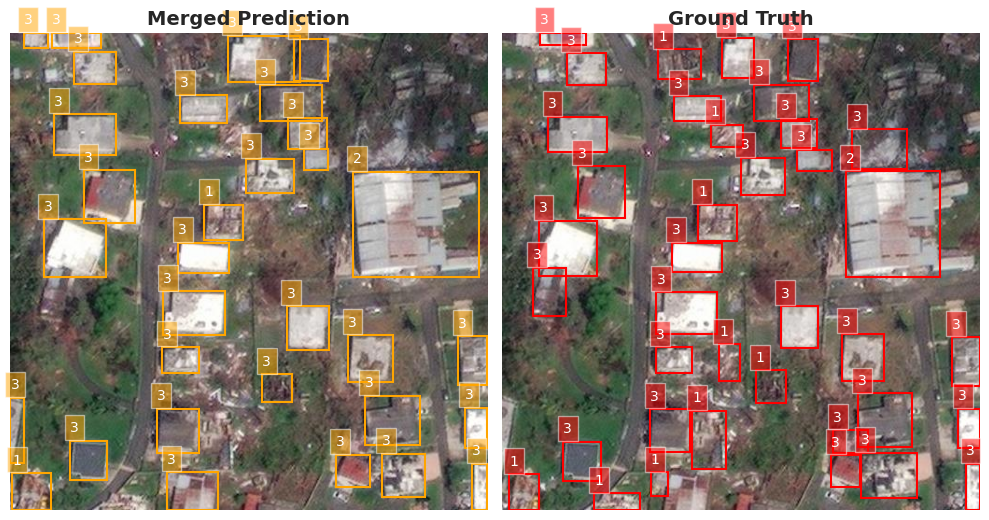


image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_009_jpg.rf.ea40d1c007170898659af43bd1ebd4dd.jpg: 512x512 1 Damaged, 21 Undamageds, 42.9ms
Speed: 1.7ms preprocess, 42.9ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 512)

image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_009_jpg.rf.ea40d1c007170898659af43bd1ebd4dd.jpg: 512x512 2 Commercials, 21 Residentials, 42.8ms
Speed: 1.0ms preprocess, 42.8ms inference, 1.4ms postprocess per image at shape (1, 3, 512, 512)


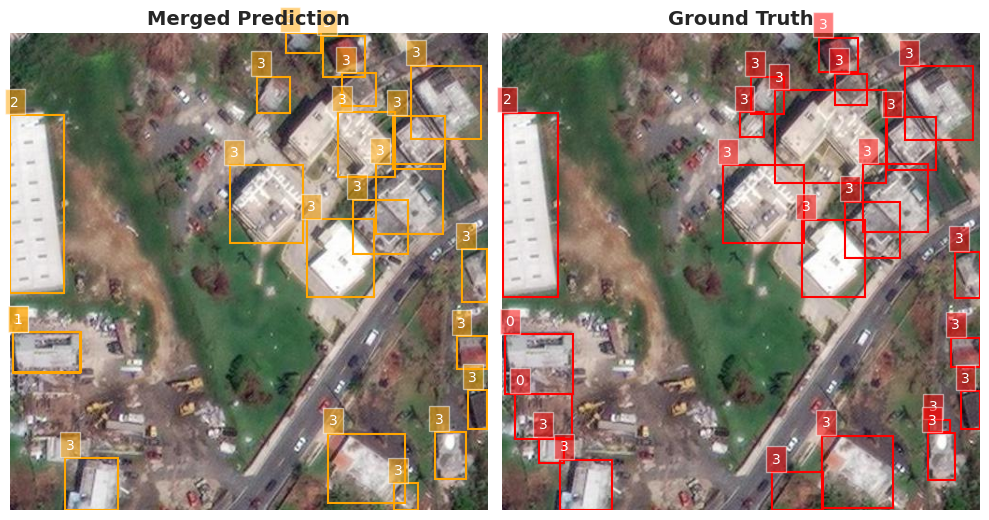


image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_001.rf.e8fd1fe84d2a38d881a2ca281853819b.jpg: 512x512 3 Damageds, 32 Undamageds, 55.7ms
Speed: 1.2ms preprocess, 55.7ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 512)

image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_001.rf.e8fd1fe84d2a38d881a2ca281853819b.jpg: 512x512 32 Residentials, 55.7ms
Speed: 1.5ms preprocess, 55.7ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 512)


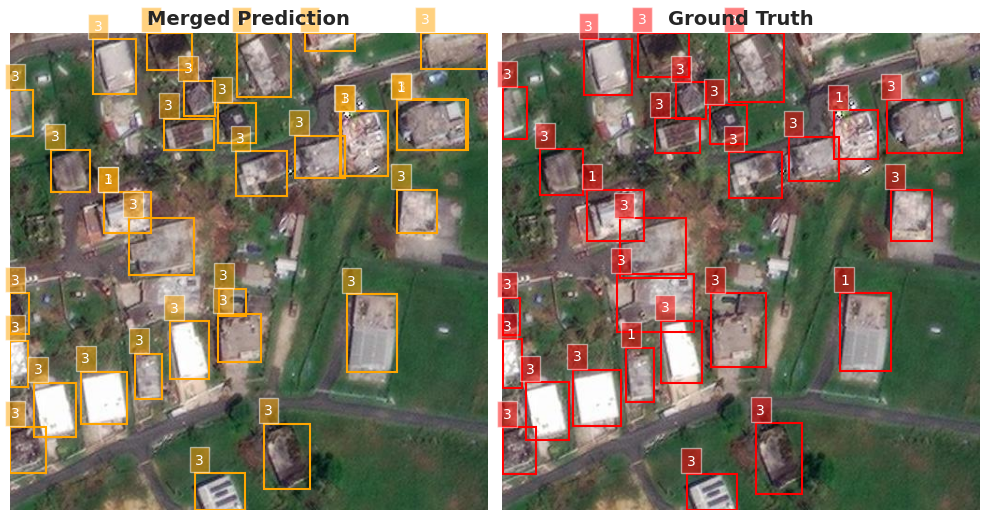


image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_012_jpg.rf.576edf4d2c34a2bc4ff0bbc74831075d.jpg: 512x512 1 Damaged, 28 Undamageds, 49.6ms
Speed: 1.6ms preprocess, 49.6ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 512)

image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_012_jpg.rf.576edf4d2c34a2bc4ff0bbc74831075d.jpg: 512x512 2 Commercials, 29 Residentials, 49.6ms
Speed: 1.1ms preprocess, 49.6ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 512)


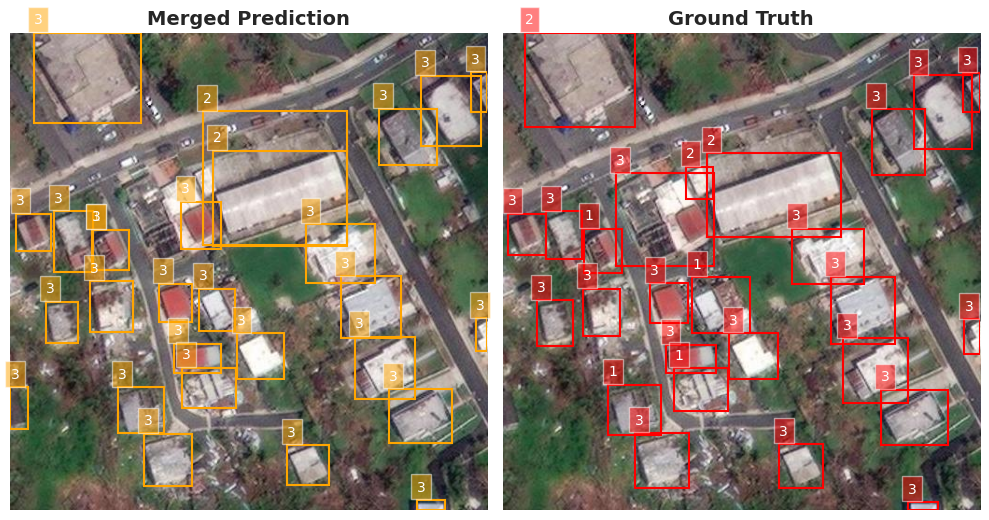


image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_011_jpg.rf.727d63e0af0282774a37ef0f06331784.jpg: 512x512 1 Damaged, 18 Undamageds, 55.7ms
Speed: 1.1ms preprocess, 55.7ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 512)

image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_011_jpg.rf.727d63e0af0282774a37ef0f06331784.jpg: 512x512 4 Commercials, 10 Residentials, 55.6ms
Speed: 1.0ms preprocess, 55.6ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 512)


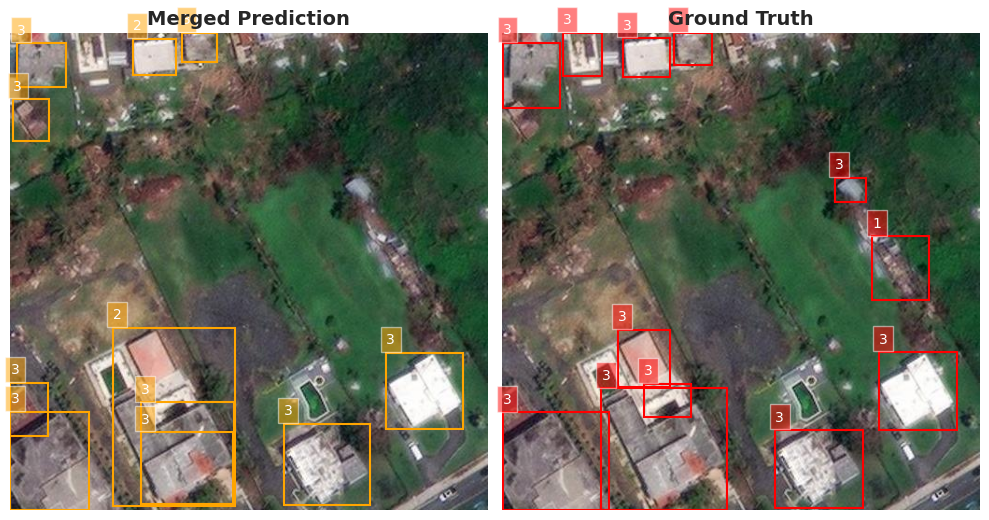


image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_003_jpg.rf.2270c6415449a627bb9f5c122bd7c484.jpg: 512x512 5 Damageds, 11 Undamageds, 47.8ms
Speed: 1.2ms preprocess, 47.8ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 512)

image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_003_jpg.rf.2270c6415449a627bb9f5c122bd7c484.jpg: 512x512 15 Residentials, 47.7ms
Speed: 1.1ms preprocess, 47.7ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 512)


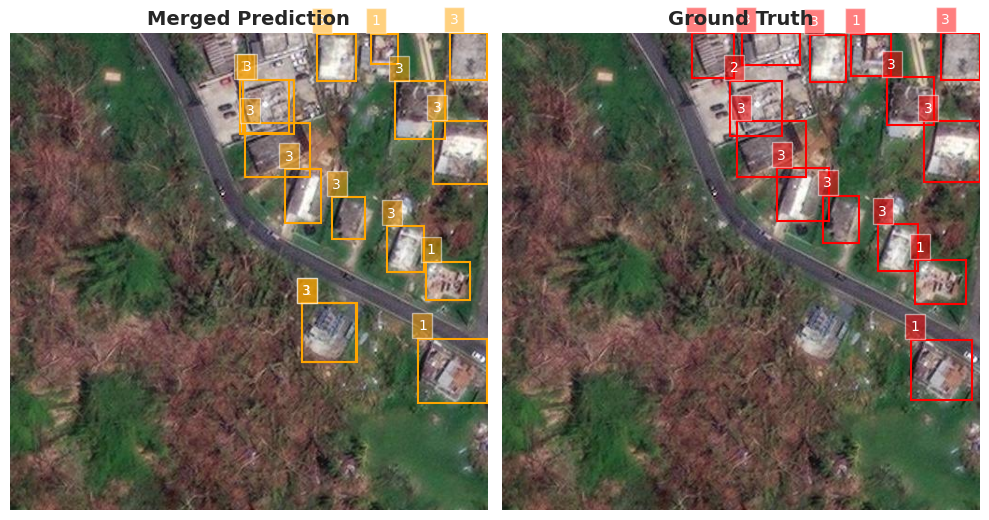


image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_002_jpg.rf.6a5c87deaca79e80f53cf5b5e2cb0569.jpg: 512x512 2 Damageds, 10 Undamageds, 41.2ms
Speed: 1.5ms preprocess, 41.2ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 512)

image 1/1 /kaggle/working/Storm-Damage-8/test/images/Validation_Post_Event_002_jpg.rf.6a5c87deaca79e80f53cf5b5e2cb0569.jpg: 512x512 16 Residentials, 41.0ms
Speed: 1.0ms preprocess, 41.0ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 512)


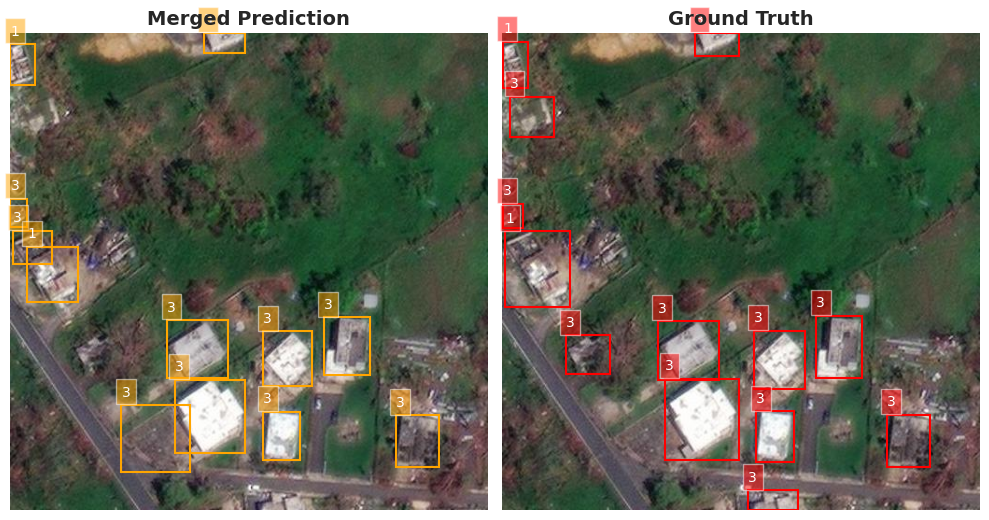

In [122]:
total_precision = 0
total_recall = 0
total_f1_score = 0

for img_file in test_image_files:
    img_path = os.path.join(test_images_dir, img_file)
    
    bda_predictions = []
    btc_predictions = []
    
    bda_result = bda_model(img_path)[0]
    btc_result = btc_model(img_path)[0]
    
    for box in bda_result.boxes:
        if box.cls.size(0) > 0:
            bda_predictions.append({
                'image_path': img_path,
                'x_min': box.xyxy[0][0].item(),
                'y_min': box.xyxy[0][1].item(),
                'x_max': box.xyxy[0][2].item(),
                'y_max': box.xyxy[0][3].item(),
                'class_name': bda_result.names[box.cls[0].item()],
                'confidence': box.conf[0].item()
            })

    for box in btc_result.boxes:
        if box.cls.size(0) > 0:
            btc_predictions.append({
                'image_path': img_path,
                'x_min': box.xyxy[0][0].item(),
                'y_min': box.xyxy[0][1].item(),
                'x_max': box.xyxy[0][2].item(),
                'y_max': box.xyxy[0][3].item(),
                'class_name': btc_result.names[box.cls[0].item()],
                'confidence': box.conf[0].item()
            })
            
    # Merge results of BDA and BTC predictions
    merged_predictions = merge_predictions(bda_predictions, btc_predictions)
    ground_truth = load_ground_truth(img_path, test_labels_dir)
    
    precision, recall, f1_score = calculate_metrics(merged_predictions, ground_truth, image_width=width, image_height=height)
    total_precision += precision
    total_recall += recall
    total_f1_score += f1_score
    
    # Visualize ground truth, BDA prediction, BTC prediction, and merged prediction
    visualize_bounding_boxes(dataset_dir, output_dir, bda_predictions, btc_predictions, merged_predictions, img_path)

In [123]:
num_images = len(test_image_files)
avg_precision = total_precision / num_images
avg_recall = total_recall / num_images
avg_f1_score = total_f1_score / num_images

print(f"Average Precision: {avg_precision:.4f}")
print(f"Average Recall: {avg_recall:.4f}")
print(f"Average F1-Score: {avg_f1_score:.4f}")

Average Precision: 0.7044
Average Recall: 0.7056
Average F1-Score: 0.7027
